# Regression project

# Explanation


For our regression project for the course of datamining ,
We decided to do a study of the covid19 evolution and did a case 
study of the evolution in different countries.

We used different datasets coming from different sources
to have different information about covid19 in different countries like the number 
of hospitalisation and new cases per days

We used all theses informations and merged them into one dataframe
to be able to make predictions about covid 19.

We uses different technics to select our features and
used multiple regression techniques like 
Decision Trees , SVM and Linear Regression.

We did a study on two features , the new cases per days and the 
new deaths per day.

Here is our project

We got our data form the official covid github that contains data about the covid19 since it's beginning

https://github.com/owid/covid-19-data/tree/master/public/data

https://covid.ourworldindata.org/data/owid-covid-data.csv

note:concerning the number of new cases and new deaths , the dataset can contains negatives values , reason why our graphs sometimes go into negative values during predictionS. It appear when a country corrects historical data, because it had previously overestimated the number of cases/deaths.




# Get the data

We first imported module we would need for our project

In [1]:
from numpy import *
import numpy as np 
import pandas as pd 
from __future__ import division, print_function, unicode_literals

# Common imports
import numpy as np
import os

# to make this notebook's output stable across runs
np.random.seed(42)

# To plot pretty figures
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

# Where to save the figures
PROJECT_ROOT_DIR = "."
CHAPTER_ID = "end_to_end_project"
IMAGES_PATH = os.path.join(PROJECT_ROOT_DIR, "images", CHAPTER_ID)

def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=300):
    path = os.path.join(IMAGES_PATH, fig_id + "." + fig_extension)
    print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format=fig_extension, dpi=resolution)

# Ignore useless warnings (see SciPy issue #5998)
import warnings
warnings.filterwarnings(action="ignore", message="^internal gelsd")

import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import preprocessing
import time
from datetime import datetime
from scipy import integrate, optimize
import warnings
warnings.filterwarnings('ignore')
from sklearn import linear_model

import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
%matplotlib inline
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.feature_selection import RFE
from sklearn.linear_model import RidgeCV, LassoCV, Ridge, Lasso

import matplotlib.pyplot as plt
from sklearn.datasets import load_iris
from sklearn.datasets import load_breast_cancer
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
import pandas as pd
import numpy as np
from sklearn import tree
from sklearn.tree import export_graphviz  


from bokeh.plotting import output_notebook, figure, show
from bokeh.models import ColumnDataSource, Div, Select, Button, ColorBar, CustomJS
from bokeh.layouts import row, column, layout
from bokeh.transform import cumsum, linear_cmap
from bokeh.palettes import Blues8, Spectral3
from bokeh.plotting import figure, output_file, show

output_notebook()

# Visualisation libraries
import matplotlib.pyplot as plt
%matplotlib inline




import sys

from plotly import tools
import plotly.graph_objects as go
import plotly.express as px
import plotly.offline as py
import plotly.figure_factory as ff
py.init_notebook_mode(connected=True)

Loading BokehJS ...

In [2]:
covid=pd.read_csv("covid.csv",delimiter=",")
covid

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,gdp_per_capita,extreme_poverty,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index
0,AFG,Asia,Afghanistan,2020-01-23,NaN,0.0,NaN,NaN,0.0,NaN,...,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.498
1,AFG,Asia,Afghanistan,2020-01-24,NaN,0.0,NaN,NaN,0.0,NaN,...,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.498
2,AFG,Asia,Afghanistan,2020-01-25,NaN,0.0,NaN,NaN,0.0,NaN,...,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.498
3,AFG,Asia,Afghanistan,2020-01-26,NaN,0.0,NaN,NaN,0.0,NaN,...,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.498
4,AFG,Asia,Afghanistan,2020-01-27,NaN,0.0,NaN,NaN,0.0,NaN,...,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.498
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60284,ZWE,Africa,Zimbabwe,2020-11-28,9822.0,108.0,92.857,275.0,0.0,1.429,...,1899.775,21.4,307.846,1.82,1.6,30.7,36.791,1.7,61.49,0.535
60285,ZWE,Africa,Zimbabwe,2020-11-29,9822.0,0.0,86.000,275.0,0.0,1.000,...,1899.775,21.4,307.846,1.82,1.6,30.7,36.791,1.7,61.49,0.535
60286,ZWE,Africa,Zimbabwe,2020-11-30,9950.0,128.0,91.714,276.0,1.0,0.429,...,1899.775,21.4,307.846,1.82,1.6,30.7,36.791,1.7,61.49,0.535
60287,ZWE,Africa,Zimbabwe,2020-12-01,10129.0,179.0,104.429,277.0,1.0,0.429,...,1899.775,21.4,307.846,1.82,1.6,30.7,36.791,1.7,61.49,0.535


In [3]:
covid.info

<bound method DataFrame.info of       iso_code continent     location        date  total_cases  new_cases  \
0          AFG      Asia  Afghanistan  2020-01-23          NaN        0.0   
1          AFG      Asia  Afghanistan  2020-01-24          NaN        0.0   
2          AFG      Asia  Afghanistan  2020-01-25          NaN        0.0   
3          AFG      Asia  Afghanistan  2020-01-26          NaN        0.0   
4          AFG      Asia  Afghanistan  2020-01-27          NaN        0.0   
...        ...       ...          ...         ...          ...        ...   
60284      ZWE    Africa     Zimbabwe  2020-11-28       9822.0      108.0   
60285      ZWE    Africa     Zimbabwe  2020-11-29       9822.0        0.0   
60286      ZWE    Africa     Zimbabwe  2020-11-30       9950.0      128.0   
60287      ZWE    Africa     Zimbabwe  2020-12-01      10129.0      179.0   
60288      ZWE    Africa     Zimbabwe  2020-12-02      10129.0        0.0   

       new_cases_smoothed  total_deaths  ne

In [4]:
covid.describe()
covid.isnull().sum()

iso_code                                315
continent                               631
location                                  0
date                                      0
total_cases                            8739
new_cases                               123
new_cases_smoothed                     1079
total_deaths                          16582
new_deaths                              123
new_deaths_smoothed                    1079
total_cases_per_million                9039
new_cases_per_million                   438
new_cases_smoothed_per_million         1389
total_deaths_per_million              16869
new_deaths_per_million                  438
new_deaths_smoothed_per_million        1389
reproduction_rate                     20292
icu_patients                          55595
icu_patients_per_million              55595
hosp_patients                         54610
hosp_patients_per_million             54610
weekly_icu_admissions                 59832
weekly_icu_admissions_per_millio

We visualized the different values in the features of our dataset

Saving figure attribute_histogram_plots


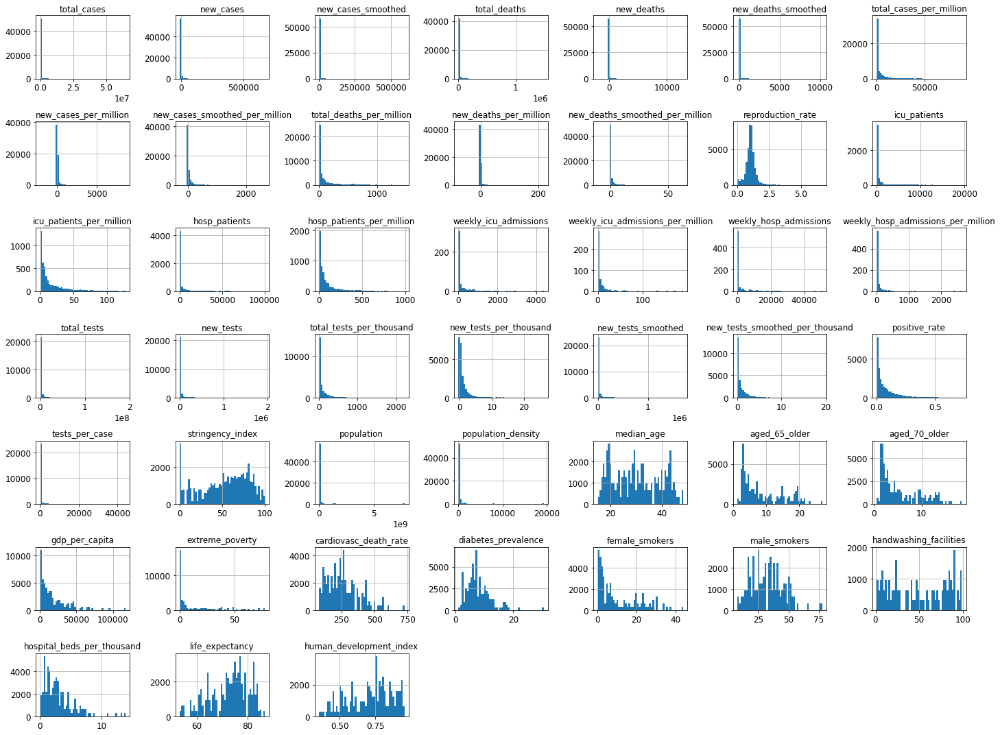

In [5]:
import matplotlib.pyplot as plt
covid.hist(bins=50, figsize=(20,15))
save_fig("attribute_histogram_plots")
plt.show()

In [6]:
import numpy as np

# For illustration only. Sklearn has train_test_split()
def split_train_test(data, test_ratio):
    shuffled_indices = np.random.permutation(len(data))
    test_set_size = int(len(data) * test_ratio)
    test_indices = shuffled_indices[:test_set_size]
    train_indices = shuffled_indices[test_set_size:]
    return data.iloc[train_indices], data.iloc[test_indices]

We created a training and a test dataset

In [7]:
train, test = split_train_test(covid, 0.2)
print(len(train), "train +", len(test), "test")
train=train.fillna(train.median())
train.isnull().sum()

48232 train + 12057 test


iso_code                                253
continent                               503
location                                  0
date                                      0
total_cases                               0
new_cases                                 0
new_cases_smoothed                        0
total_deaths                              0
new_deaths                                0
new_deaths_smoothed                       0
total_cases_per_million                   0
new_cases_per_million                     0
new_cases_smoothed_per_million            0
total_deaths_per_million                  0
new_deaths_per_million                    0
new_deaths_smoothed_per_million           0
reproduction_rate                         0
icu_patients                              0
icu_patients_per_million                  0
hosp_patients                             0
hosp_patients_per_million                 0
weekly_icu_admissions                     0
weekly_icu_admissions_per_millio

We used the plotly module to visualize the evolution of the number of cases per countries from the beginning to the day we downloaded the dataset

In [8]:
temp = train.groupby(['date', 'location'])['total_cases'].sum().reset_index()
temp['date'] = pd.to_datetime(temp['date'])
temp['date'] = temp['date'].dt.strftime('%m/%d/%Y')
temp['size'] = temp['total_cases'].pow(0.3) * 3.5
temp=temp.fillna(temp.median())
fig = px.scatter_geo(temp, locations="location", locationmode='country names', 
                     color="total_cases", size='size', hover_name="location", 
                     range_color=[1,100],
                     projection="natural earth", animation_frame="date", 
                     title='COVID-19: Cases Over Time', color_continuous_scale="greens")
fig.show()

In [9]:
temp = train.groupby(['date', 'location'])['total_deaths'].sum().reset_index()
temp['date'] = pd.to_datetime(temp['date'])
temp['date'] = temp['date'].dt.strftime('%m/%d/%Y')
temp['size'] = temp['total_deaths'].pow(0.3) * 3.5
temp=temp.fillna(temp.median())
fig = px.scatter_geo(temp, locations="location", locationmode='country names', 
                     color="total_deaths", size='size', hover_name="location", 
                     range_color=[1,100],
                     projection="natural earth", animation_frame="date", 
                     title='COVID-19: Deaths Over Time', color_continuous_scale="reds")
fig.show()

In [10]:
display(train.head(5))
display(train.describe())
print("Number of Country_Region: ", train['location'].nunique())
print("Dates go from day", max(train['date']), "to day", min(train['date']), ", a total of", train['date'].nunique(), "days")
print("Continents with Province/State informed: ", train.loc[train['location']!='None']['continent'].unique())

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,gdp_per_capita,extreme_poverty,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index
35721,MNG,Asia,Mongolia,2020-02-24,3569.0,0.0,0.000,119.0,0.0,0.000,...,11840.846,0.5,460.043,4.82,5.5,46.5,71.180,7.000,69.87,0.741
56365,GBR,Europe,United Kingdom,2020-07-14,292931.0,1240.0,722.429,40984.0,44.0,28.857,...,39753.244,0.2,122.137,4.28,20.0,24.7,49.542,2.540,81.32,0.922
24614,NaN,NaN,International,2020-11-06,721.0,0.0,0.000,15.0,0.0,0.000,...,11840.846,2.5,243.964,7.11,6.2,31.4,49.542,2.397,74.25,0.741
45916,SAU,Asia,Saudi Arabia,2020-06-18,145991.0,4757.0,4281.429,1139.0,48.0,40.286,...,49045.411,2.5,259.538,17.72,1.8,25.4,49.542,2.700,75.13,0.853
47141,SLE,Africa,Sierra Leone,2020-05-14,408.0,21.0,25.286,26.0,0.0,1.429,...,1390.300,52.2,325.721,2.42,8.8,41.3,19.275,2.397,54.70,0.419


,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_cases_per_million,new_cases_per_million,new_cases_smoothed_per_million,total_deaths_per_million,...,gdp_per_capita,extreme_poverty,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index
count,4.823200e+04,48232.000000,48232.000000,4.823200e+04,48232.000000,48232.000000,48232.000000,48232.000000,48232.000000,48232.000000,...,48232.000000,48232.000000,48232.000000,48232.000000,48232.000000,48232.000000,48232.000000,48232.000000,48232.000000,48232.000000
mean,1.833050e+05,2150.847155,2097.207291,5.862806e+03,49.374751,48.285117,3077.403621,38.624229,37.559512,77.922496,...,18058.475395,9.878904,261.229105,7.877264,9.291006,32.292975,49.991775,2.922997,72.847395,0.710266
std,1.894388e+06,20437.235426,19816.646608,5.335431e+04,414.594252,394.244890,6666.033395,134.978052,105.181381,169.633770,...,18930.817270,17.164513,118.046650,4.127443,9.133185,11.573562,22.379541,2.287721,7.508845,0.150454
min,1.000000e+00,-10034.000000,-525.000000,1.000000e+00,-1918.000000,-232.143000,0.001000,-2153.437000,-276.825000,0.001000,...,661.240000,0.100000,79.370000,0.990000,0.100000,7.700000,1.188000,0.100000,53.280000,0.354000
25%,5.680000e+02,0.000000,0.429000,4.500000e+01,0.000000,0.000000,116.047500,0.000000,0.085000,6.735000,...,4449.898000,1.300000,175.695000,5.310000,2.800000,25.000000,49.542000,1.400000,67.270000,0.590000
50%,3.569000e+03,13.000000,18.714000,1.190000e+02,0.000000,0.286000,564.207000,1.666000,2.756000,19.073500,...,11840.846000,2.500000,243.964000,7.110000,6.200000,31.400000,49.542000,2.397000,74.250000,0.741000
75%,2.177650e+04,248.000000,254.429000,4.222500e+02,4.000000,4.143000,2574.202000,22.808000,24.481000,49.442250,...,25063.846000,6.000000,329.635000,10.080000,13.000000,37.700000,49.542000,3.700000,77.970000,0.816000
max,6.450818e+07,672046.000000,592662.143000,1.492636e+06,12782.000000,10263.714000,88552.385000,8652.658000,2648.773000,1459.151000,...,116935.600000,77.600000,724.417000,30.530000,44.000000,78.100000,98.999000,13.800000,86.750000,0.953000


Number of Country_Region:  192
Dates go from day 2020-12-02 to day 2020-01-01 , a total of 337 days
Continents with Province/State informed:  ['Asia' 'Europe' nan 'Africa' 'Oceania' 'South America' 'North America']


We visualized how the number of new cases and new deaths evolved since the beginning in the world , France , USA , CHINA , 
Italy , Togo , Lebanon 

Text(0.5, 0, 'Date')

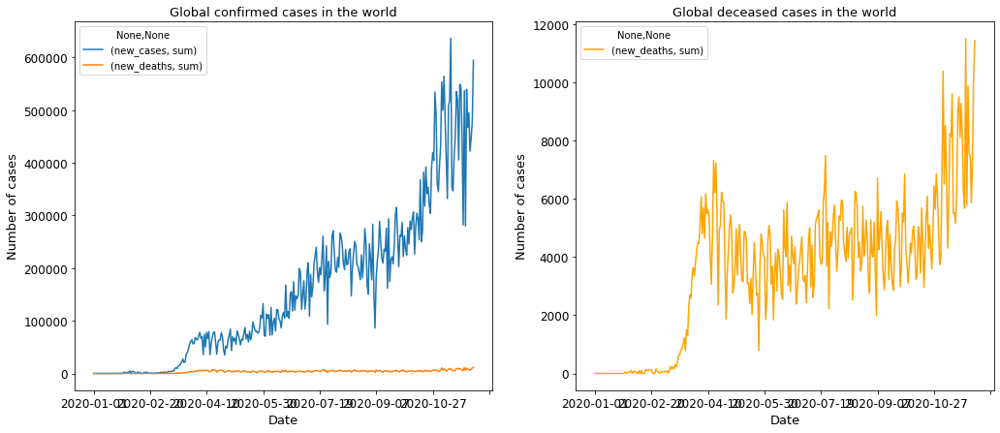

In [11]:
confirmed_total_date_noChina = train[train['location']!='World'].groupby(['date']).agg({'new_cases':['sum']})
fatalities_total_date_noChina = train[train['location']!='World'].groupby(['date']).agg({'new_deaths':['sum']})
total_date_noChina = confirmed_total_date_noChina.join(fatalities_total_date_noChina)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(17,7))
total_date_noChina.plot(ax=ax1)
ax1.set_title("Global confirmed cases in the world", size=13)
ax1.set_ylabel("Number of cases", size=13)
ax1.set_xlabel("Date", size=13)
fatalities_total_date_noChina.plot(ax=ax2, color='orange')
ax2.set_title("Global deceased cases in the world", size=13)
ax2.set_ylabel("Number of cases", size=13)
ax2.set_xlabel("Date", size=13)

Text(0.5, 0, 'Date')

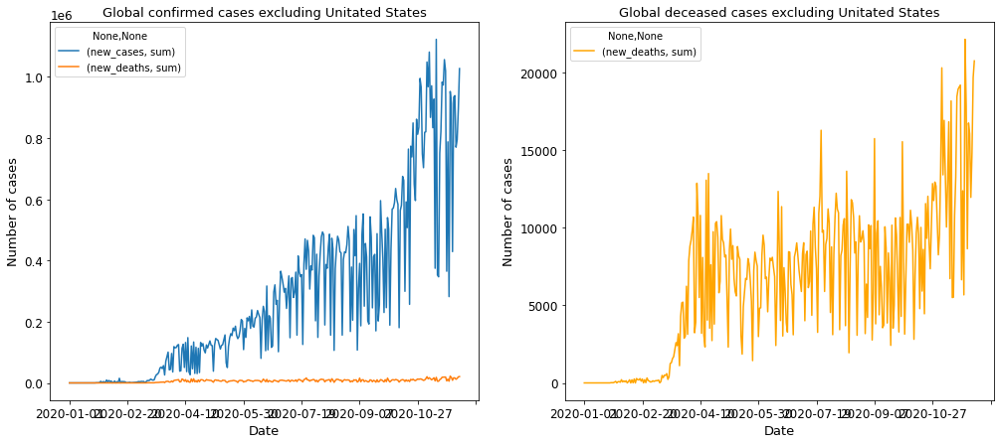

In [12]:
confirmed_total_date_noChina = train[train['location']!='United States'].groupby(['date']).agg({'new_cases':['sum']})
fatalities_total_date_noChina = train[train['location']!='United States'].groupby(['date']).agg({'new_deaths':['sum']})
total_date_noChina = confirmed_total_date_noChina.join(fatalities_total_date_noChina)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(17,7))
total_date_noChina.plot(ax=ax1)
ax1.set_title("Global confirmed cases excluding Unitated States", size=13)
ax1.set_ylabel("Number of cases", size=13)
ax1.set_xlabel("Date", size=13)
fatalities_total_date_noChina.plot(ax=ax2, color='orange')
ax2.set_title("Global deceased cases excluding Unitated States", size=13)
ax2.set_ylabel("Number of cases", size=13)
ax2.set_xlabel("Date", size=13)

Text(0.5, 0, 'Date')

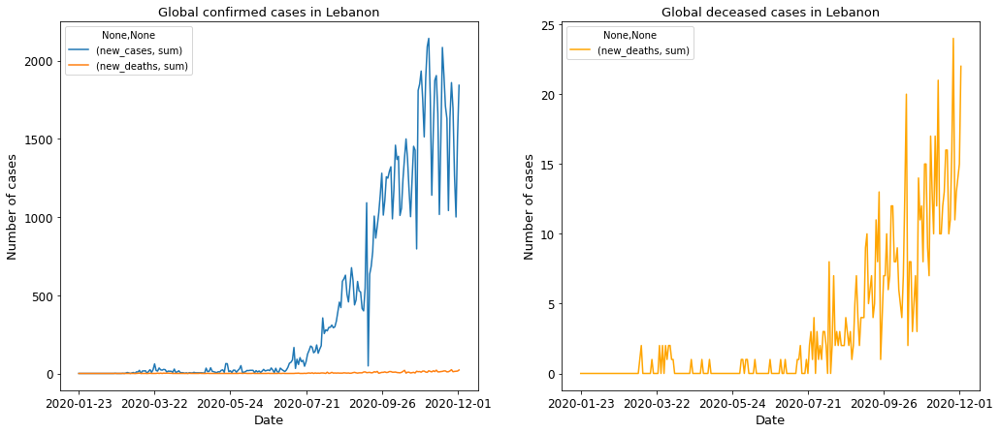

In [13]:
confirmed_total_date_noChina = train[train['location']=='Lebanon'].groupby(['date']).agg({'new_cases':['sum']})
fatalities_total_date_noChina = train[train['location']=='Lebanon'].groupby(['date']).agg({'new_deaths':['sum']})
total_date_noChina = confirmed_total_date_noChina.join(fatalities_total_date_noChina)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(17,7))
total_date_noChina.plot(ax=ax1)
ax1.set_title("Global confirmed cases in Lebanon", size=13)
ax1.set_ylabel("Number of cases", size=13)
ax1.set_xlabel("Date", size=13)
fatalities_total_date_noChina.plot(ax=ax2, color='orange')
ax2.set_title("Global deceased cases in Lebanon", size=13)
ax2.set_ylabel("Number of cases", size=13)
ax2.set_xlabel("Date", size=13)

Text(0.5, 0, 'Date')

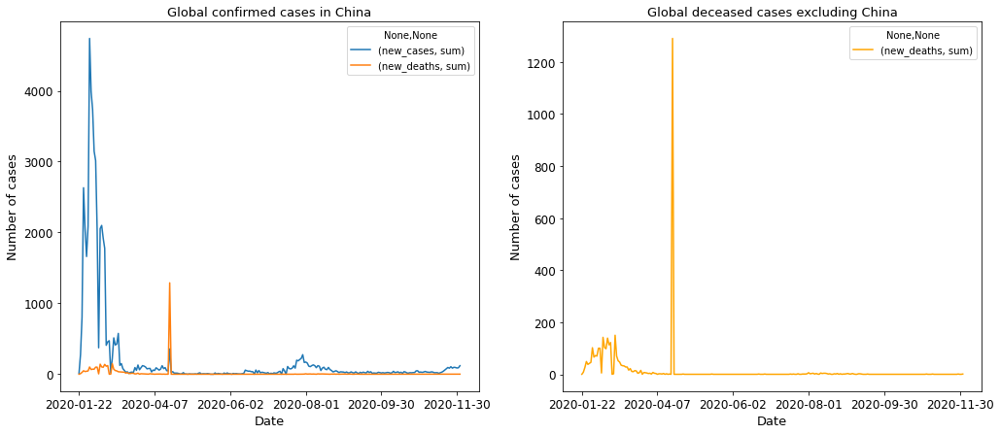

In [14]:
confirmed_total_date_noChina = train[train['location']=='China'].groupby(['date']).agg({'new_cases':['sum']})
fatalities_total_date_noChina = train[train['location']=='China'].groupby(['date']).agg({'new_deaths':['sum']})
total_date_noChina = confirmed_total_date_noChina.join(fatalities_total_date_noChina)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(17,7))
total_date_noChina.plot(ax=ax1)
ax1.set_title("Global confirmed cases in China", size=13)
ax1.set_ylabel("Number of cases", size=13)
ax1.set_xlabel("Date", size=13)
fatalities_total_date_noChina.plot(ax=ax2, color='orange')
ax2.set_title("Global deceased cases excluding China", size=13)
ax2.set_ylabel("Number of cases", size=13)
ax2.set_xlabel("Date", size=13)

Text(0.5, 0, 'Date')

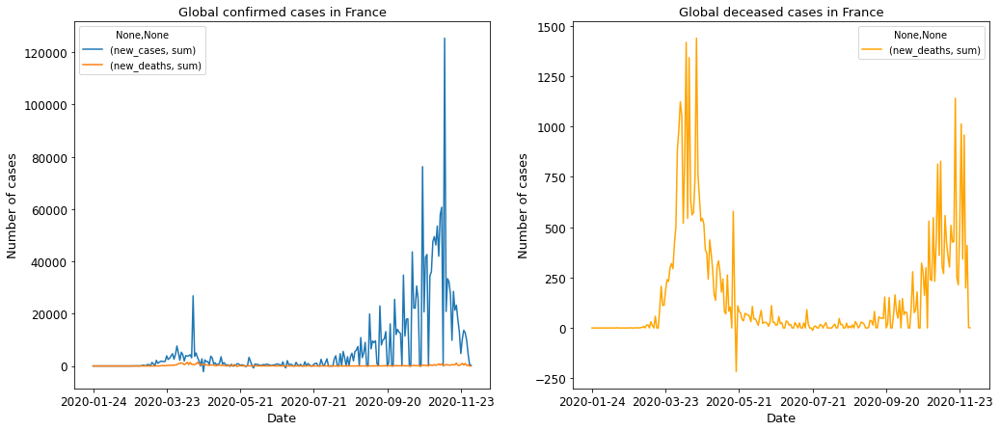

In [15]:
confirmed_total_date_noChina = train[train['location']=='France'].groupby(['date']).agg({'new_cases':['sum']})
fatalities_total_date_noChina = train[train['location']=='France'].groupby(['date']).agg({'new_deaths':['sum']})
total_date_noChina = confirmed_total_date_noChina.join(fatalities_total_date_noChina)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(17,7))
total_date_noChina.plot(ax=ax1)
ax1.set_title("Global confirmed cases in France", size=13)
ax1.set_ylabel("Number of cases", size=13)
ax1.set_xlabel("Date", size=13)
fatalities_total_date_noChina.plot(ax=ax2, color='orange')
ax2.set_title("Global deceased cases in France", size=13)
ax2.set_ylabel("Number of cases", size=13)
ax2.set_xlabel("Date", size=13)

Text(0.5, 0, 'Date')

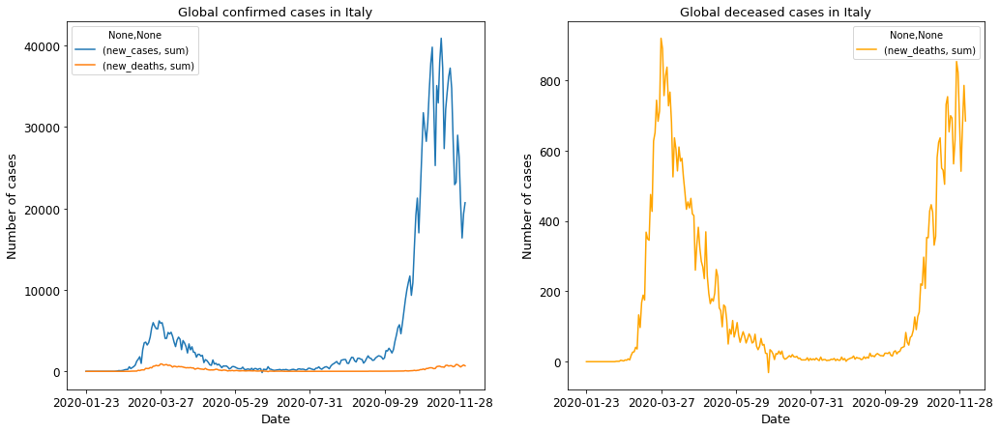

In [16]:
confirmed_total_date_noChina = train[train['location']=='Italy'].groupby(['date']).agg({'new_cases':['sum']})
fatalities_total_date_noChina = train[train['location']=='Italy'].groupby(['date']).agg({'new_deaths':['sum']})
total_date_noChina = confirmed_total_date_noChina.join(fatalities_total_date_noChina)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(17,7))
total_date_noChina.plot(ax=ax1)
ax1.set_title("Global confirmed cases in Italy", size=13)
ax1.set_ylabel("Number of cases", size=13)
ax1.set_xlabel("Date", size=13)
fatalities_total_date_noChina.plot(ax=ax2, color='orange')
ax2.set_title("Global deceased cases in Italy", size=13)
ax2.set_ylabel("Number of cases", size=13)
ax2.set_xlabel("Date", size=13)

Text(0.5, 0, 'Date')

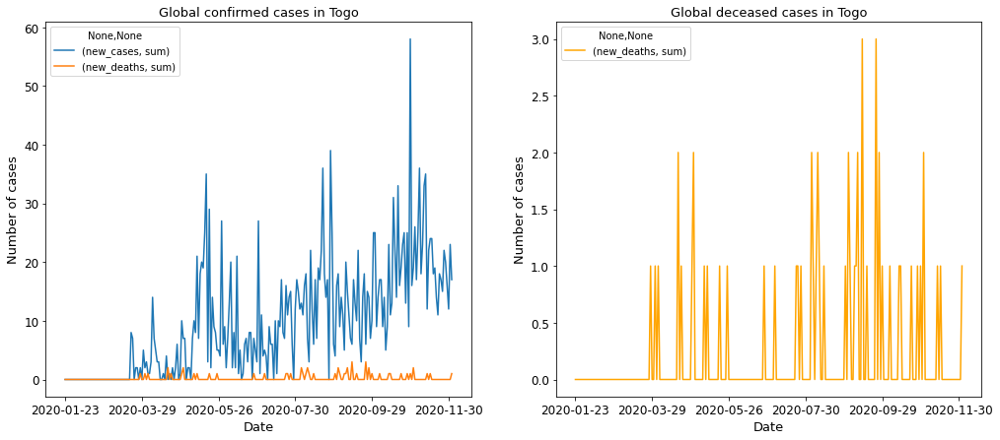

In [17]:
confirmed_total_date_noChina = train[train['location']=='Togo'].groupby(['date']).agg({'new_cases':['sum']})
fatalities_total_date_noChina = train[train['location']=='Togo'].groupby(['date']).agg({'new_deaths':['sum']})
total_date_noChina = confirmed_total_date_noChina.join(fatalities_total_date_noChina)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(17,7))
total_date_noChina.plot(ax=ax1)
ax1.set_title("Global confirmed cases in Togo", size=13)
ax1.set_ylabel("Number of cases", size=13)
ax1.set_xlabel("Date", size=13)
fatalities_total_date_noChina.plot(ax=ax2, color='orange')
ax2.set_title("Global deceased cases in Togo", size=13)
ax2.set_ylabel("Number of cases", size=13)
ax2.set_xlabel("Date", size=13)

We visualized the data for Italy , Spain , UK and Singapore next to each other

            sum
date           
2020-01-23  0.0
2020-01-25  0.0
2020-01-26  0.0
2020-01-27  0.0
2020-01-28  0.0
...         ...
2020-11-25  0.0
2020-11-26  0.0
2020-11-30  0.0
2020-12-01  0.0
2020-12-02  0.0

[259 rows x 1 columns]


<AxesSubplot:title={'center':'Singapore'}, xlabel='date'>

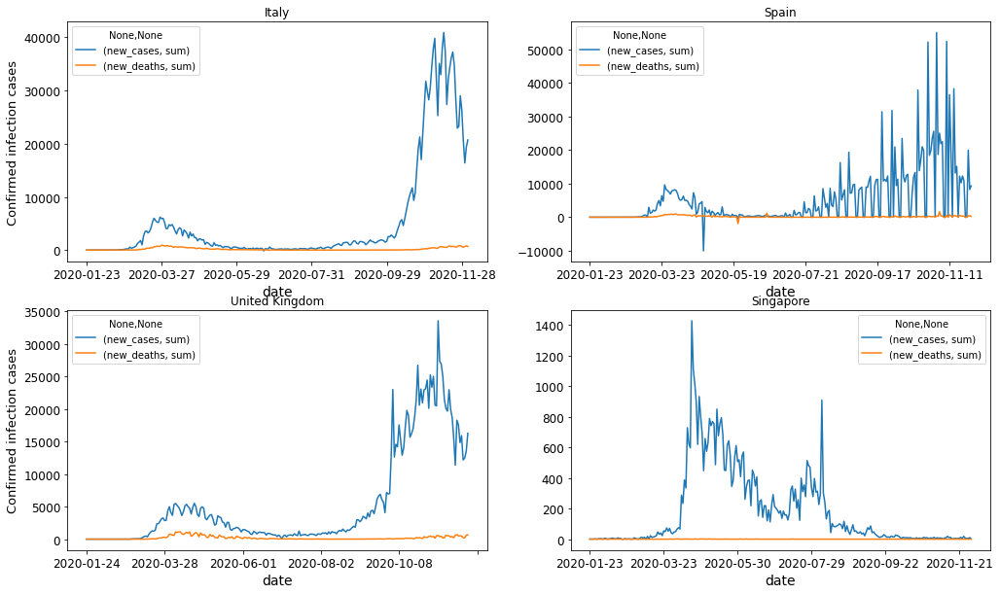

In [18]:
confirmed_total_date_Italy = train[train['location']=='Italy'].groupby(['date']).agg({'new_cases':['sum']})
fatalities_total_date_Italy = train[train['location']=='Italy'].groupby(['date']).agg({'new_deaths':['sum']})
total_date_Italy = confirmed_total_date_Italy.join(fatalities_total_date_Italy)

#confirmed_country_Spain = train[train['Country_Region']=='Spain'].groupby(['Country_Region', 'Province_State']).agg({'ConfirmedCases':['sum']})
#fatalities_country_Spain = train[train['Country_Region']=='Spain'].groupby(['Country_Region', 'Province_State']).agg({'Fatalities':['sum']})
confirmed_total_date_Spain  = train[train['location']=='Spain'].groupby(['date']).agg({'new_cases':['sum']})
fatalities_total_date_Spain = train[train['location']=='Spain'].groupby(['date']).agg({'new_deaths':['sum']})
total_date_Spain = confirmed_total_date_Spain.join(fatalities_total_date_Spain)

#confirmed_country_UK = train[train['Country_Region']=='United Kingdom'].groupby(['Country_Region', 'Province_State']).agg({'ConfirmedCases':['sum']})
#fatalities_country_UK = train[train['Country_Region']=='United Kingdom'].groupby(['Country_Region', 'Province_State']).agg({'Fatalities':['sum']})
confirmed_total_date_UK = train[train['location']=='United Kingdom'].groupby(['date']).agg({'new_cases':['sum']})
fatalities_total_date_UK = train[train['location']=='United Kingdom'].groupby(['date']).agg({'new_deaths':['sum']})
total_date_UK = confirmed_total_date_UK.join(fatalities_total_date_UK)

#confirmed_country_Australia = train[train['Country_Region']=='Australia'].groupby(['Country_Region', 'Province_State']).agg({'ConfirmedCases':['sum']})
#fatalities_country_Australia = train[train['Country_Region']=='Australia'].groupby(['Country_Region', 'Province_State']).agg({'Fatalities':['sum']})
confirmed_total_date_Australia  = train[train['location']=='Australia'].groupby(['date']).agg({'new_cases':['sum']})
fatalities_total_date_Australia  = train[train['location']=='Australia'].groupby(['date']).agg({'new_deaths':['sum']})
total_date_Australia = confirmed_total_date_Australia.join(fatalities_total_date_Australia)

#confirmed_country_Singapore = train[train['Country_Region']=='Singapore'].groupby(['Country_Region', 'Province_State']).agg({'ConfirmedCases':['sum']})
#fatalities_country_Singapore = train[train['Country_Region']=='Singapore'].groupby(['Country_Region', 'Province_State']).agg({'Fatalities':['sum']})
confirmed_total_date_Singapore  = train[train['location']=='Singapore'].groupby(['date']).agg({'new_cases':['sum']})
fatalities_total_date_Singapore  = train[train['location']=='Singapore'].groupby(['date']).agg({'new_deaths':['sum']})
total_date_Singapore = confirmed_total_date_Singapore.join(fatalities_total_date_Singapore)
print(total_date_Singapore.new_deaths)
plt.figure(figsize=(17,10))
plt.subplot(2, 2, 1)
total_date_Italy.plot(ax=plt.gca(), title='Italy')
plt.ylabel("Confirmed infection cases", size=13)

plt.subplot(2, 2, 2)
total_date_Spain.plot(ax=plt.gca(), title='Spain')

plt.subplot(2, 2, 3)
total_date_UK.plot(ax=plt.gca(), title='United Kingdom')
plt.ylabel("Confirmed infection cases", size=13)

plt.subplot(2, 2, 4)
total_date_Singapore.plot(ax=plt.gca(), title='Singapore')

5850343
67886004
46754783
           new_cases new_deaths
                 sum        sum
date                           
2020-01-23       0.0        0.0
2020-01-25       0.0        0.0
2020-01-26       0.0        0.0
2020-01-27       0.0        0.0
2020-01-28       0.0        0.0
...              ...        ...
2020-11-28   26315.0      686.0
2020-11-29   20646.0      541.0
2020-11-30   16376.0      672.0
2020-12-01   19347.0      785.0
2020-12-02   20709.0      684.0

[255 rows x 2 columns]


(0.0, 0.05)

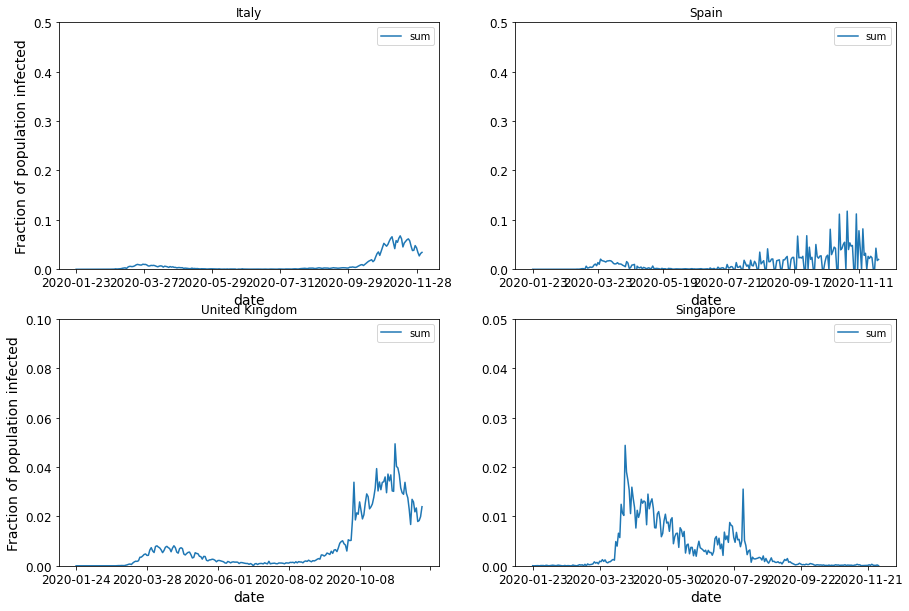

In [19]:
pop_italy = int(train.loc[train['location']=='Italy']['population'].unique())
pop_spain = int(train.loc[train['location']=='Spain']['population'].unique())
pop_UK = int(train.loc[train['location']=='United Kingdom']['population'].unique())
pop_singapore = int(train.loc[train['location']=='Singapore']['population'].unique())
print(pop_singapore)
print(pop_UK)
print(pop_spain)
print(total_date_Italy)


total_date_Italy.new_cases = total_date_Italy.new_cases/pop_italy*100.
total_date_Italy.new_deaths = total_date_Italy.new_deaths/pop_italy*100.
total_date_Spain.new_cases = total_date_Spain.new_cases/pop_spain*100.
total_date_Spain.new_deaths = total_date_Spain.new_deaths/pop_spain*100.
total_date_UK.new_cases = total_date_UK.new_cases/pop_UK*100.
total_date_UK.new_deaths = total_date_UK.new_deaths/pop_UK*100.
total_date_Singapore.new_cases = total_date_Singapore.new_cases/pop_singapore*100.
total_date_Singapore.new_deaths = total_date_Singapore.new_deaths/pop_singapore*100.

plt.figure(figsize=(15,10))
plt.subplot(2, 2, 1)
total_date_Italy.new_cases.plot(ax=plt.gca(), title='Italy')
plt.ylabel("Fraction of population infected")
plt.ylim(0, 0.5)

plt.subplot(2, 2, 2)
total_date_Spain.new_cases.plot(ax=plt.gca(), title='Spain')
plt.ylim(0, 0.5)

plt.subplot(2, 2, 3)
total_date_UK.new_cases.plot(ax=plt.gca(), title='United Kingdom')
plt.ylabel("Fraction of population infected")
plt.ylim(0, 0.1)

plt.subplot(2, 2, 4)
total_date_Singapore.new_cases.plot(ax=plt.gca(), title='Singapore')
plt.ylim(0, 0.05)

We made a visualization of how the infections evolved in 4 differents countries since the beginning

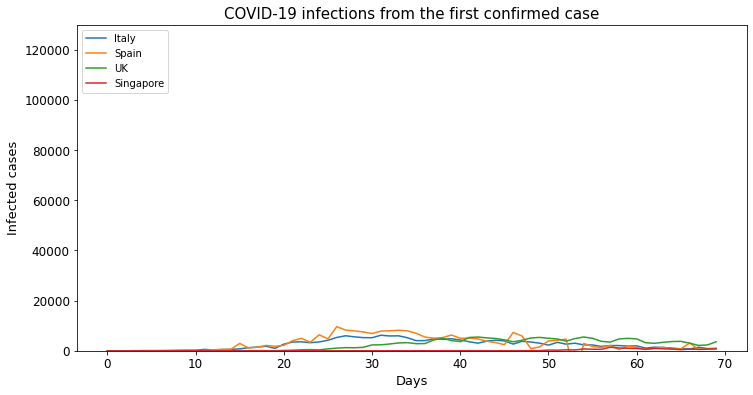

In [20]:
confirmed_total_date_Italy = train[(train['location']=='Italy') & train['new_cases']!=0].groupby(['date']).agg({'new_cases':['sum']})
fatalities_total_date_Italy = train[(train['location']=='Italy') & train['new_cases']!=0].groupby(['date']).agg({'new_deaths':['sum']})
total_date_Italy = confirmed_total_date_Italy.join(fatalities_total_date_Italy)

#confirmed_country_Spain = train[(train['Country_Region']=='Spain') & (train['ConfirmedCases']!=0)].groupby(['Country_Region', 'Province_State']).agg({'ConfirmedCases':['sum']})
#fatalities_country_Spain = train[(train['Country_Region']=='Spain') & (train['ConfirmedCases']!=0)].groupby(['Country_Region', 'Province_State']).agg({'Fatalities':['sum']})
confirmed_total_date_Spain = train[(train['location']=='Spain') & (train['new_cases']!=0)].groupby(['date']).agg({'new_cases':['sum']})
fatalities_total_date_Spain = train[(train['location']=='Spain') & (train['new_cases']!=0)].groupby(['date']).agg({'new_deaths':['sum']})
total_date_Spain = confirmed_total_date_Spain.join(fatalities_total_date_Spain)

#confirmed_country_UK = train[(train['Country_Region']=='United Kingdom') & (train['ConfirmedCases']!=0)].groupby(['Country_Region', 'Province_State']).agg({'ConfirmedCases':['sum']})
#fatalities_country_UK = train[(train['Country_Region']=='United Kingdom') & (train['ConfirmedCases']!=0)].groupby(['Country_Region', 'Province_State']).agg({'Fatalities':['sum']})
confirmed_total_date_UK = train[(train['location']=='United Kingdom') & (train['new_cases']!=0)].groupby(['date']).agg({'new_cases':['sum']})
fatalities_total_date_UK = train[(train['location']=='United Kingdom') & (train['new_cases']!=0)].groupby(['date']).agg({'new_deaths':['sum']})
total_date_UK = confirmed_total_date_UK.join(fatalities_total_date_UK)

#confirmed_country_Australia = train[(train['Country_Region']=='Australia') & (train['ConfirmedCases']!=0)].groupby(['Country_Region', 'Province_State']).agg({'ConfirmedCases':['sum']})
#fatalities_country_Australia = train[(train['Country_Region']=='Australia') & (train['ConfirmedCases']!=0)].groupby(['Country_Region', 'Province_State']).agg({'Fatalities':['sum']})
confirmed_total_date_Australia = train[(train['location']=='Australia') & (train['new_cases']!=0)].groupby(['date']).agg({'new_cases':['sum']})
fatalities_total_date_Australia = train[(train['location']=='Australia') & (train['new_cases']!=0)].groupby(['date']).agg({'new_deaths':['sum']})
total_date_Australia = confirmed_total_date_Australia.join(fatalities_total_date_Australia)

#confirmed_country_Singapore = train[(train['Country_Region']=='Singapore') & (train['ConfirmedCases']!=0)].groupby(['Country_Region', 'Province_State']).agg({'ConfirmedCases':['sum']})
#fatalities_country_Singapore = train[(train['Country_Region']=='Singapore') & (train['ConfirmedCases']!=0)].groupby(['Country_Region', 'Province_State']).agg({'Fatalities':['sum']})
confirmed_total_date_Singapore = train[(train['location']=='Singapore') & (train['new_cases']!=0)].groupby(['date']).agg({'new_cases':['sum']})
fatalities_total_date_Singapore = train[(train['location']=='Singapore') & (train['new_cases']!=0)].groupby(['date']).agg({'new_deaths':['sum']})
total_date_Singapore = confirmed_total_date_Singapore.join(fatalities_total_date_Singapore)

italy = [i for i in total_date_Italy.new_cases['sum'].values]
italy_30 = italy[0:70] 
spain = [i for i in total_date_Spain.new_cases['sum'].values]
spain_30 = spain[0:70] 
UK = [i for i in total_date_UK.new_cases['sum'].values]
UK_30 = UK[0:70] 
singapore = [i for i in total_date_Singapore.new_cases['sum'].values]
singapore_30 = singapore[0:70] 


# Plots
plt.figure(figsize=(12,6))
plt.plot(italy_30)
plt.plot(spain_30)
plt.plot(UK_30)
plt.plot(singapore_30)
plt.legend(["Italy", "Spain", "UK", "Singapore"], loc='upper left')
plt.title("COVID-19 infections from the first confirmed case", size=15)
plt.xlabel("Days", size=13)
plt.ylabel("Infected cases", size=13)
plt.ylim(0, 130000)
plt.show()

# SIR MODEL

source:https://en.wikipedia.org/wiki/Compartmental_models_in_epidemiology

We have seen some general behavior of the virus in agregated data, for the country where the coronavirus was originated and for four other interesting countries. There's a lot of information to be extracted from this data; for example, we haven't analyzed the effects of long/lat of countries. However, since our main purpose is to develop a predective model in order to understand the key factors that impact the COVID-19 transmission, I'll move on to one of the most famous epidemiologic models: SIR.

SIR is a simple model that considers a population that belongs to one of the following states:

Susceptible (S). The individual hasn't contracted the disease, but she can be infected due to transmisison from infected people
Infected (I). This person has contracted the disease
Recovered/Deceased (R). The disease may lead to one of two destinies: either the person survives, hence developing inmunity to the disease, or the person is deceased.
Image by Kai Sasaki from lewuathe.com

There are several variations of this model, taking into account birth and death (SIRD with demography), intermediate states, etc. However, since we are in the early stages of the expansion of COVID-19 and our attention is focused on the short term, we will consider that people gain immunity (in the long term, immunity may be lost and COVID-19 may return within a certain seasonality such as the common flu) and there is no transition from recovery to the remaining two states.The differential equations that control the system are:

dS/dt=−βSIN
 
dI/dt=βSIN−γI
 
dR/dt=γI
 
Where  β  is the contagion rate of the pathogen and  γ  is the recovery rate.



We then implamented the SIR MODEL with python

the fa function calculates the number of susceptible individuals meaning the people who got infected by another infected person.

the fb function calculates the number of infected individuals.

the fc function calculates the number of recovered individuals.

In [21]:
# Susceptible equation
def fa(N, a, b, beta):
    fa = -beta*a*b
    return fa

# Infected equation
def fb(N, a, b, beta, gamma):
    fb = beta*a*b - gamma*b
    return fb

# Recovered/deceased equation
def fc(N, b, gamma):
    fc = gamma*b
    return fc

The iterative formula of RK4 method for solving ODE (1) is as follows

yn+1=yn+Δt6(k1+2k2+2k3+k4)

k1=f(tn,yn)

k2=f(tn+Δt2,yn+k1Δt2)

k3=f(tn+Δt2,yn+k2Δt2)

k4=f(tn+Δt,yn+k3Δt

t_n+1=tn+Δt

n=0,1,2,3,…(2)

After that, we created the SIR method that will return three arrays: The Susceptible, the Infected and the Recovered so that we can plot simulate the spread of the virus.

In [22]:
def rK4(N, a, b, c, fa, fb, fc, beta, gamma, hs):
    a1 = fa(N, a, b, beta)*hs
    b1 = fb(N, a, b, beta, gamma)*hs
    c1 = fc(N, b, gamma)*hs
    ak = a + a1*0.5
    bk = b + b1*0.5
    ck = c + c1*0.5
    a2 = fa(N, ak, bk, beta)*hs
    b2 = fb(N, ak, bk, beta, gamma)*hs
    c2 = fc(N, bk, gamma)*hs
    ak = a + a2*0.5
    bk = b + b2*0.5
    ck = c + c2*0.5
    a3 = fa(N, ak, bk, beta)*hs
    b3 = fb(N, ak, bk, beta, gamma)*hs
    c3 = fc(N, bk, gamma)*hs
    ak = a + a3
    bk = b + b3
    ck = c + c3
    a4 = fa(N, ak, bk, beta)*hs
    b4 = fb(N, ak, bk, beta, gamma)*hs
    c4 = fc(N, bk, gamma)*hs
    a = a + (a1 + 2*(a2 + a3) + a4)/6
    b = b + (b1 + 2*(b2 + b3) + b4)/6
    c = c + (c1 + 2*(c2 + c3) + c4)/6
    return a, b, c

In [23]:
def SIR(N, b0, beta, gamma, hs):

    # Initial condition
    a = float(N-1)/N -b0
    b = float(1)/N +b0
    c = 0.

    sus, inf, rec= [],[],[]
    for i in range(10000): # Run for a certain number of time-steps
        sus.append(a)
        inf.append(b)
        rec.append(c)
        a,b,c = rK4(N, a, b, c, fa, fb, fc, beta, gamma, hs)

    return sus, inf, rec

In [24]:
who=pd.read_csv("country.csv",delimiter=",")
who

,Country/Region,Confirmed,Deaths,Recovered,Active,New cases,New deaths,New recovered,Deaths / 100 Cases,Recovered / 100 Cases,Deaths / 100 Recovered,Confirmed last week,1 week change,1 week % increase,WHO Region
0,Afghanistan,36263,1269,25198,9796,106,10,18,3.50,69.49,5.04,35526,737,2.07,Eastern Mediterranean
1,Albania,4880,144,2745,1991,117,6,63,2.95,56.25,5.25,4171,709,17.00,Europe
2,Algeria,27973,1163,18837,7973,616,8,749,4.16,67.34,6.17,23691,4282,18.07,Africa
3,Andorra,907,52,803,52,10,0,0,5.73,88.53,6.48,884,23,2.60,Europe
4,Angola,950,41,242,667,18,1,0,4.32,25.47,16.94,749,201,26.84,Africa
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
182,West Bank and Gaza,10621,78,3752,6791,152,2,0,0.73,35.33,2.08,8916,1705,19.12,Eastern Mediterranean
183,Western Sahara,10,1,8,1,0,0,0,10.00,80.00,12.50,10,0,0.00,Africa
184,Yemen,1691,483,833,375,10,4,36,28.56,49.26,57.98,1619,72,4.45,Eastern Mediterranean
185,Zambia,4552,140,2815,1597,71,1,465,3.08,61.84,4.97,3326,1226,36.86,Africa


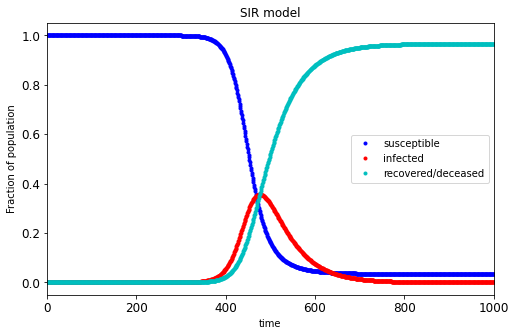

In [25]:
N = 7800*(10**6)
b0 = 0
beta = 0.7
gamma = 0.2
hs = 0.1

sus, inf, rec = SIR(N, b0, beta, gamma, hs)

f = plt.figure(figsize=(8,5)) 
plt.plot(sus, 'b.', label='susceptible');
plt.plot(inf, 'r.', label='infected');
plt.plot(rec, 'c.', label='recovered/deceased');
plt.title("SIR model")
plt.xlabel("time", fontsize=10);
plt.ylabel("Fraction of population", fontsize=10);
plt.legend(loc='best')
plt.xlim(0,1000)
plt.savefig('SIR_example.png')
plt.show()

Real data

46754783


,new_cases,day_count
50089,8581.0,1
49940,5029.0,2
50030,0.0,3
50035,852.0,4
50128,0.0,5
...,...,...
50118,9419.0,252
49922,4053.0,253
50132,13318.0,254
50108,31428.0,255


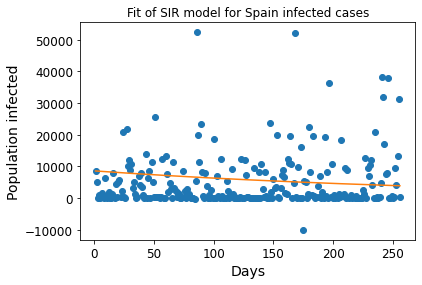

Optimal parameters: beta = -0.001263075703370661  and gamma =  0.001815357832251582


In [26]:
population = int(train.loc[train['location']=='Spain']['population'].unique())
country_df = pd.DataFrame()
country_df['new_cases'] = train.loc[train['location']=='Spain'].new_cases.fillna(0)
country_df = country_df[10:]
country_df['day_count'] = list(range(1,len(country_df)+1))
print(population)
ydata = [i for i in country_df.new_cases]
xdata = country_df.day_count
ydata = np.array(ydata, dtype=float)
xdata = np.array(xdata, dtype=float)


display(country_df)
N = population
inf0 = ydata[0]
sus0 = N - inf0
rec0 = 0.0

def sir_model(y, x, beta, gamma):
    sus = -beta * y[0] * y[1] / N
    rec = gamma * y[1]
    inf = -(sus + rec)
    return sus, inf, rec

def fit_odeint(x, beta, gamma):
    return integrate.odeint(sir_model, (sus0, inf0, rec0), x, args=(beta, gamma))[:,1]

popt, pcov = optimize.curve_fit(fit_odeint, xdata, ydata)
fitted = fit_odeint(xdata, *popt)

plt.plot(xdata, ydata, 'o')
plt.plot(xdata, fitted)
plt.title("Fit of SIR model for Spain infected cases")
plt.ylabel("Population infected")
plt.xlabel("Days")
plt.show()
print("Optimal parameters: beta =", popt[0], " and gamma = ", popt[1])

1439323774


,new_cases,day_count
11281,25.0,1
11189,19.0,2
11327,29.0,3
11054,458.0,4
11163,4.0,5
...,...,...
11338,88.0,239
11261,22.0,240
11093,76.0,241
11111,357.0,242


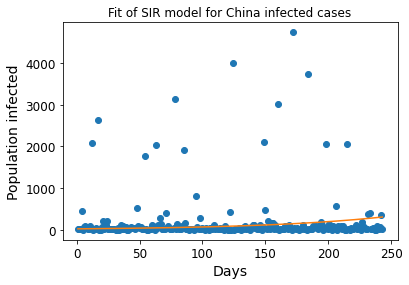

Optimal parameters: beta = 1.0144950957674699  and gamma =  1.0041081491741175


In [27]:
population = int(train.loc[train['location']=='China']['population'].unique())
country_df = pd.DataFrame()
country_df['new_cases'] = train.loc[train['location']=='China'].new_cases.fillna(0)
country_df = country_df[10:]
country_df['day_count'] = list(range(1,len(country_df)+1))
print(population)

ydata = [i for i in country_df.new_cases]
xdata = country_df.day_count
ydata = np.array(ydata, dtype=float)
xdata = np.array(xdata, dtype=float)


display(country_df)
N = population
inf0 = ydata[0]
sus0 = N - inf0
rec0 = 0.0

def sir_model(y, x, beta, gamma):
    sus = -beta * y[0] * y[1] / N
    rec = gamma * y[1]
    inf = -(sus + rec)
    return sus, inf, rec

def fit_odeint(x, beta, gamma):
    return integrate.odeint(sir_model, (sus0, inf0, rec0), x, args=(beta, gamma))[:,1]

popt, pcov = optimize.curve_fit(fit_odeint, xdata, ydata)
fitted = fit_odeint(xdata, *popt)

plt.plot(xdata, ydata, 'o')
plt.plot(xdata, fitted)
plt.title("Fit of SIR model for China infected cases")
plt.ylabel("Population infected")
plt.xlabel("Days")
plt.show()
print("Optimal parameters: beta =", popt[0], " and gamma = ", popt[1])

65273512


,new_cases,day_count
18844,17867.0,1
18848,0.0,2
18843,11447.0,3
18701,63.0,4
18622,19.0,5
...,...,...
18755,659.0,244
18777,1.0,245
18888,23247.0,246
18711,191.0,247


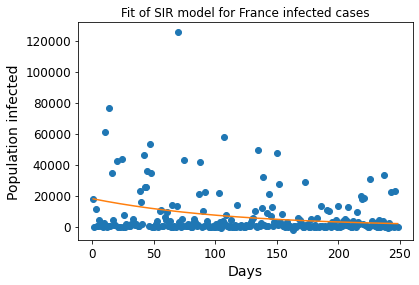

Optimal parameters: beta = 0.12300073777639631  and gamma =  0.1317902872240923


In [28]:
population = int(train.loc[train['location']=='France']['population'].unique())
country_df = pd.DataFrame()
country_df['new_cases'] = train.loc[train['location']=='France'].new_cases.fillna(0)
country_df = country_df[10:]
country_df['day_count'] = list(range(1,len(country_df)+1))

ydata = [i for i in country_df.new_cases]
xdata = country_df.day_count
ydata = np.array(ydata, dtype=float)
xdata = np.array(xdata, dtype=float)

print(population)

display(country_df)
N = population
inf0 = ydata[0]
sus0 = N - inf0
rec0 = 0.0

def sir_model(y, x, beta, gamma):
    sus = -beta * y[0] * y[1] / N
    rec = gamma * y[1]
    inf = -(sus + rec)
    return sus, inf, rec

def fit_odeint(x, beta, gamma):
    return integrate.odeint(sir_model, (sus0, inf0, rec0), x, args=(beta, gamma))[:,1]

popt, pcov = optimize.curve_fit(fit_odeint, xdata, ydata)
fitted = fit_odeint(xdata, *popt)

plt.plot(xdata, ydata, 'o')
plt.plot(xdata, fitted)
plt.title("Fit of SIR model for France infected cases")
plt.ylabel("Population infected")
plt.xlabel("Days")
plt.show()
print("Optimal parameters: beta =", popt[0], " and gamma = ", popt[1])

# Data Enrichment

To help our work , we added data coming from two datasets

The references and country dataset in https://github.com/datasets/covid-19

We used :
references : to have data about the countries, that weren't in the original like provinces

Countries: to have another source on the number of deaths , cases and more important the recoveries that we hadn't in the
previous one.

It would help provide us more data for the feature selection part.

We studied these datasets , aggregates informations and combined them


In [29]:
countries=pd.read_csv("countries.csv",delimiter=",")
countries

,Date,Country,Confirmed,Recovered,Deaths
0,2020-01-22,Afghanistan,0,0,0
1,2020-01-23,Afghanistan,0,0,0
2,2020-01-24,Afghanistan,0,0,0
3,2020-01-25,Afghanistan,0,0,0
4,2020-01-26,Afghanistan,0,0,0
...,...,...,...,...,...
61627,2020-12-03,Zimbabwe,10424,8754,280
61628,2020-12-04,Zimbabwe,10547,8802,281
61629,2020-12-05,Zimbabwe,10617,8844,291
61630,2020-12-06,Zimbabwe,10718,8880,291


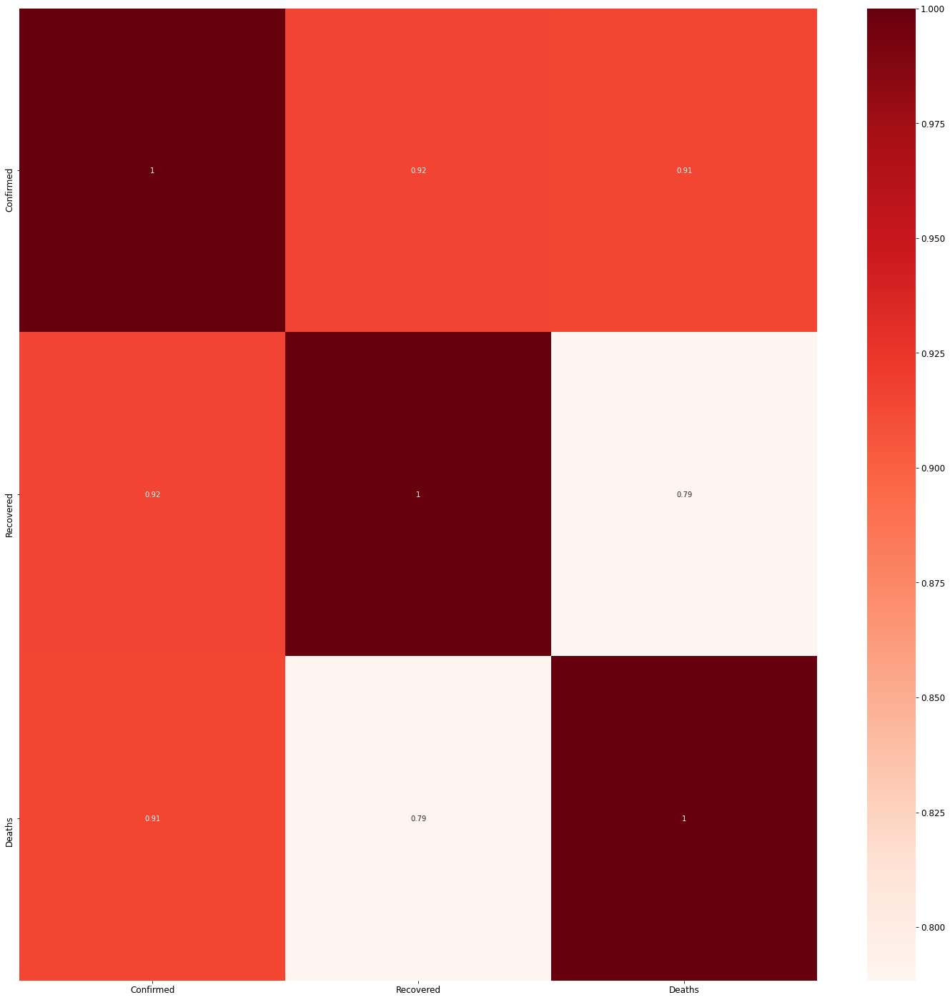

In [30]:
plt.figure(figsize=(25,25))
cor = countries.corr()
sns.heatmap(cor, annot=True, cmap=plt.cm.Reds)
plt.show()

In [31]:
references=pd.read_csv("reference.csv",delimiter=",")
references

,UID,iso2,iso3,code3,FIPS,Admin2,Province_State,Country_Region,Lat,Long_,Combined_Key,Population
0,4,AF,AFG,4.0,NaN,NaN,NaN,Afghanistan,33.939110,67.709953,Afghanistan,38928341.0
1,8,AL,ALB,8.0,NaN,NaN,NaN,Albania,41.153300,20.168300,Albania,2877800.0
2,12,DZ,DZA,12.0,NaN,NaN,NaN,Algeria,28.033900,1.659600,Algeria,43851043.0
3,20,AD,AND,20.0,NaN,NaN,NaN,Andorra,42.506300,1.521800,Andorra,77265.0
4,24,AO,AGO,24.0,NaN,NaN,NaN,Angola,-11.202700,17.873900,Angola,32866268.0
...,...,...,...,...,...,...,...,...,...,...,...,...
4166,84056037,US,USA,840.0,56037.0,Sweetwater,Wyoming,US,41.659439,-108.882788,"Sweetwater, Wyoming, US",42343.0
4167,84056039,US,USA,840.0,56039.0,Teton,Wyoming,US,43.935225,-110.589080,"Teton, Wyoming, US",23464.0
4168,84056041,US,USA,840.0,56041.0,Uinta,Wyoming,US,41.287818,-110.547578,"Uinta, Wyoming, US",20226.0
4169,84056043,US,USA,840.0,56043.0,Washakie,Wyoming,US,43.904516,-107.680187,"Washakie, Wyoming, US",7805.0


In [32]:
references=references.groupby('Country_Region').mean()

In [33]:
references

,UID,code3,FIPS,Lat,Long_,Population
Country_Region,,,,,,
Afghanistan,4.0,4.0,NaN,33.939110,67.709953,38928341.0
Albania,8.0,8.0,NaN,41.153300,20.168300,2877800.0
Algeria,12.0,12.0,NaN,28.033900,1.659600,43851043.0
Andorra,20.0,20.0,NaN,42.506300,1.521800,77265.0
Angola,24.0,24.0,NaN,-11.202700,17.873900,32866268.0
...,...,...,...,...,...,...
West Bank and Gaza,275.0,275.0,NaN,31.952200,35.233200,5101416.0
Western Sahara,732.0,732.0,NaN,24.215500,-12.885800,597330.0
Yemen,887.0,887.0,NaN,15.552727,48.516388,29825968.0


In [34]:
covid.loc[covid['location']== 'United States','location'] ='US' 


In [35]:
display(covid.head())
display(countries.head())

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,gdp_per_capita,extreme_poverty,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index
0,AFG,Asia,Afghanistan,2020-01-23,NaN,0.0,NaN,NaN,0.0,NaN,...,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.498
1,AFG,Asia,Afghanistan,2020-01-24,NaN,0.0,NaN,NaN,0.0,NaN,...,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.498
2,AFG,Asia,Afghanistan,2020-01-25,NaN,0.0,NaN,NaN,0.0,NaN,...,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.498
3,AFG,Asia,Afghanistan,2020-01-26,NaN,0.0,NaN,NaN,0.0,NaN,...,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.498
4,AFG,Asia,Afghanistan,2020-01-27,NaN,0.0,NaN,NaN,0.0,NaN,...,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.498


,Date,Country,Confirmed,Recovered,Deaths
0,2020-01-22,Afghanistan,0,0,0
1,2020-01-23,Afghanistan,0,0,0
2,2020-01-24,Afghanistan,0,0,0
3,2020-01-25,Afghanistan,0,0,0
4,2020-01-26,Afghanistan,0,0,0


In [36]:
all_data = covid.merge(countries, left_on=['location','date'], right_on=['Country','Date'], how='left')

In [37]:
all_data

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,Date,Country,Confirmed,Recovered,Deaths
0,AFG,Asia,Afghanistan,2020-01-23,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.498,2020-01-23,Afghanistan,0.0,0.0,0.0
1,AFG,Asia,Afghanistan,2020-01-24,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.498,2020-01-24,Afghanistan,0.0,0.0,0.0
2,AFG,Asia,Afghanistan,2020-01-25,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.498,2020-01-25,Afghanistan,0.0,0.0,0.0
3,AFG,Asia,Afghanistan,2020-01-26,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.498,2020-01-26,Afghanistan,0.0,0.0,0.0
4,AFG,Asia,Afghanistan,2020-01-27,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.498,2020-01-27,Afghanistan,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60284,ZWE,Africa,Zimbabwe,2020-11-28,9822.0,108.0,92.857,275.0,0.0,1.429,...,30.7,36.791,1.7,61.49,0.535,2020-11-28,Zimbabwe,9822.0,8472.0,275.0
60285,ZWE,Africa,Zimbabwe,2020-11-29,9822.0,0.0,86.000,275.0,0.0,1.000,...,30.7,36.791,1.7,61.49,0.535,2020-11-29,Zimbabwe,9822.0,8472.0,275.0
60286,ZWE,Africa,Zimbabwe,2020-11-30,9950.0,128.0,91.714,276.0,1.0,0.429,...,30.7,36.791,1.7,61.49,0.535,2020-11-30,Zimbabwe,9950.0,8482.0,276.0
60287,ZWE,Africa,Zimbabwe,2020-12-01,10129.0,179.0,104.429,277.0,1.0,0.429,...,30.7,36.791,1.7,61.49,0.535,2020-12-01,Zimbabwe,10129.0,8643.0,277.0


In [38]:
all_data = all_data.merge(references, left_on=['location'], right_on=['Country_Region'], how='left')

In [39]:
all_data

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,Country,Confirmed,Recovered,Deaths,UID,code3,FIPS,Lat,Long_,Population
0,AFG,Asia,Afghanistan,2020-01-23,NaN,0.0,NaN,NaN,0.0,NaN,...,Afghanistan,0.0,0.0,0.0,4.0,4.0,NaN,33.939110,67.709953,38928341.0
1,AFG,Asia,Afghanistan,2020-01-24,NaN,0.0,NaN,NaN,0.0,NaN,...,Afghanistan,0.0,0.0,0.0,4.0,4.0,NaN,33.939110,67.709953,38928341.0
2,AFG,Asia,Afghanistan,2020-01-25,NaN,0.0,NaN,NaN,0.0,NaN,...,Afghanistan,0.0,0.0,0.0,4.0,4.0,NaN,33.939110,67.709953,38928341.0
3,AFG,Asia,Afghanistan,2020-01-26,NaN,0.0,NaN,NaN,0.0,NaN,...,Afghanistan,0.0,0.0,0.0,4.0,4.0,NaN,33.939110,67.709953,38928341.0
4,AFG,Asia,Afghanistan,2020-01-27,NaN,0.0,NaN,NaN,0.0,NaN,...,Afghanistan,0.0,0.0,0.0,4.0,4.0,NaN,33.939110,67.709953,38928341.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60284,ZWE,Africa,Zimbabwe,2020-11-28,9822.0,108.0,92.857,275.0,0.0,1.429,...,Zimbabwe,9822.0,8472.0,275.0,716.0,716.0,NaN,-19.015438,29.154857,14862927.0
60285,ZWE,Africa,Zimbabwe,2020-11-29,9822.0,0.0,86.000,275.0,0.0,1.000,...,Zimbabwe,9822.0,8472.0,275.0,716.0,716.0,NaN,-19.015438,29.154857,14862927.0
60286,ZWE,Africa,Zimbabwe,2020-11-30,9950.0,128.0,91.714,276.0,1.0,0.429,...,Zimbabwe,9950.0,8482.0,276.0,716.0,716.0,NaN,-19.015438,29.154857,14862927.0
60287,ZWE,Africa,Zimbabwe,2020-12-01,10129.0,179.0,104.429,277.0,1.0,0.429,...,Zimbabwe,10129.0,8643.0,277.0,716.0,716.0,NaN,-19.015438,29.154857,14862927.0


In [40]:
le = preprocessing.LabelEncoder()
all_data['date'] = pd.to_datetime(all_data['date'])

all_data['Day_num'] = le.fit_transform(all_data.date)
all_data['Day'] = all_data['date'].dt.day
all_data['Month'] = all_data['date'].dt.month
all_data['Year'] = all_data['date'].dt.year

In [41]:
all_data

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,UID,code3,FIPS,Lat,Long_,Population,Day_num,Day,Month,Year
0,AFG,Asia,Afghanistan,2020-01-23,NaN,0.0,NaN,NaN,0.0,NaN,...,4.0,4.0,NaN,33.939110,67.709953,38928341.0,22,23,1,2020
1,AFG,Asia,Afghanistan,2020-01-24,NaN,0.0,NaN,NaN,0.0,NaN,...,4.0,4.0,NaN,33.939110,67.709953,38928341.0,23,24,1,2020
2,AFG,Asia,Afghanistan,2020-01-25,NaN,0.0,NaN,NaN,0.0,NaN,...,4.0,4.0,NaN,33.939110,67.709953,38928341.0,24,25,1,2020
3,AFG,Asia,Afghanistan,2020-01-26,NaN,0.0,NaN,NaN,0.0,NaN,...,4.0,4.0,NaN,33.939110,67.709953,38928341.0,25,26,1,2020
4,AFG,Asia,Afghanistan,2020-01-27,NaN,0.0,NaN,NaN,0.0,NaN,...,4.0,4.0,NaN,33.939110,67.709953,38928341.0,26,27,1,2020
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60284,ZWE,Africa,Zimbabwe,2020-11-28,9822.0,108.0,92.857,275.0,0.0,1.429,...,716.0,716.0,NaN,-19.015438,29.154857,14862927.0,332,28,11,2020
60285,ZWE,Africa,Zimbabwe,2020-11-29,9822.0,0.0,86.000,275.0,0.0,1.000,...,716.0,716.0,NaN,-19.015438,29.154857,14862927.0,333,29,11,2020
60286,ZWE,Africa,Zimbabwe,2020-11-30,9950.0,128.0,91.714,276.0,1.0,0.429,...,716.0,716.0,NaN,-19.015438,29.154857,14862927.0,334,30,11,2020
60287,ZWE,Africa,Zimbabwe,2020-12-01,10129.0,179.0,104.429,277.0,1.0,0.429,...,716.0,716.0,NaN,-19.015438,29.154857,14862927.0,335,1,12,2020


We got our merged dataset and we will go to the next step , feature selection

# Feature selection

# Study of new cases

# Filter Method

As the name suggest, in this method, you filter and take only the subset of the relevant features. The model is built after selecting the features. The filtering here is done using correlation matrix and it is most commonly done using Pearson correlation.
Here we will first plot the Pearson correlation heatmap and see the correlation of independent variables with the output variable MEDV. We will only select features which has correlation of above 0.5 (taking absolute value) with the output variable.
The correlation coefficient has values between -1 to 1
— A value closer to 0 implies weaker correlation (exact 0 implying no correlation)
— A value closer to 1 implies stronger positive correlation
— A value closer to -1 implies stronger negative correlation
#Using Pearson Correlation

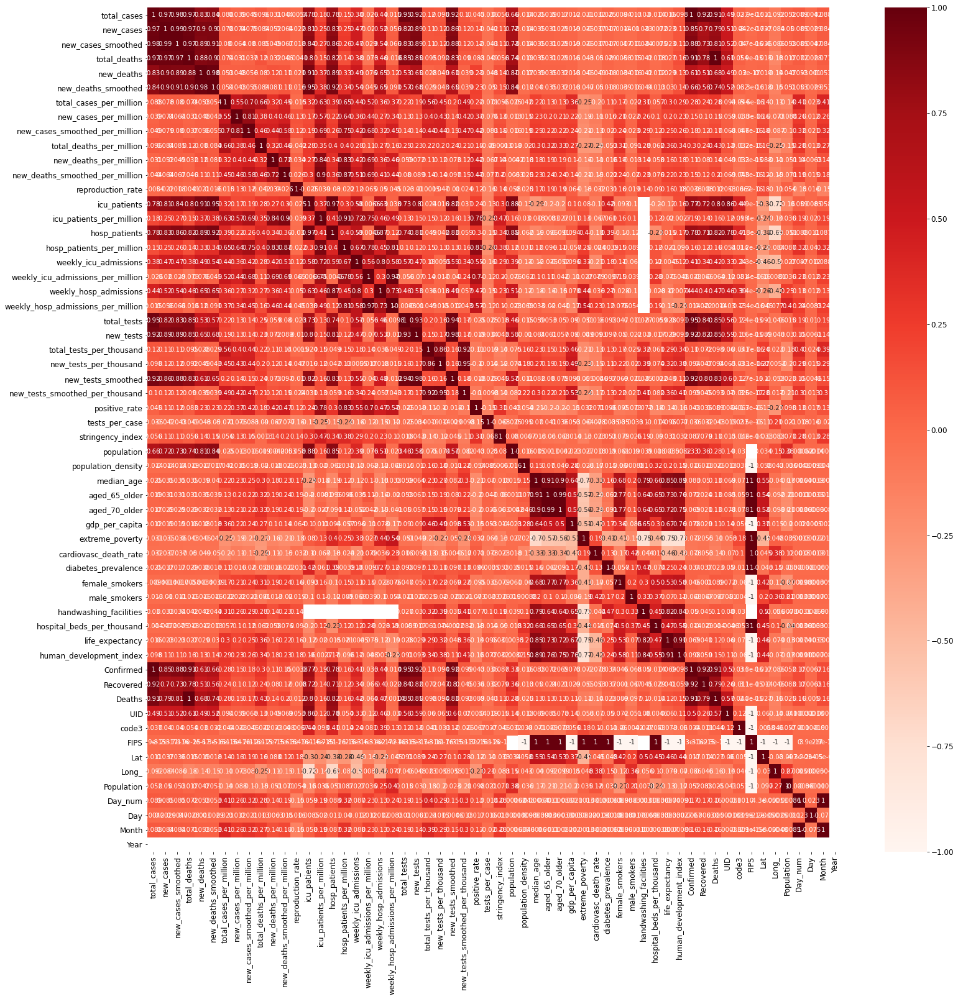

In [42]:
plt.figure(figsize=(25,25))
cor = all_data.corr()
sns.heatmap(cor, annot=True, cmap=plt.cm.Reds)
plt.show()

This is the features relevant for our study

In [43]:
cor_target = abs(cor["new_cases"])
#Selecting highly correlated features
relevant_features = cor_target[cor_target>0.5]
relevant_features

total_cases               0.967114
new_cases                 1.000000
new_cases_smoothed        0.992472
total_deaths              0.965026
new_deaths                0.896174
new_deaths_smoothed       0.897997
icu_patients              0.808436
hosp_patients             0.833182
weekly_hosp_admissions    0.515664
total_tests               0.820575
new_tests                 0.890239
new_tests_smoothed        0.863084
population                0.721367
Confirmed                 0.850141
Recovered                 0.698644
Deaths                    0.790420
UID                       0.505488
Name: new_cases, dtype: float64

In [44]:
cor_target = abs(cor["new_deaths"])
#Selecting highly correlated features
relevant_features = cor_target[cor_target>0.5]
relevant_features

total_cases               0.825953
new_cases                 0.896174
new_cases_smoothed        0.889368
total_deaths              0.880938
new_deaths                1.000000
new_deaths_smoothed       0.976216
icu_patients              0.911552
hosp_patients             0.887237
weekly_hosp_admissions    0.646036
total_tests               0.529578
new_tests                 0.652779
new_tests_smoothed        0.605371
population                0.811856
Confirmed                 0.610269
Recovered                 0.513658
Deaths                    0.677073
Name: new_deaths, dtype: float64

In [45]:
print(all_data[["new_cases","population"]].corr())
print(all_data[["new_deaths","population"]].corr())

            new_cases  population
new_cases    1.000000    0.721367
population   0.721367    1.000000
            new_deaths  population
new_deaths    1.000000    0.811856
population    0.811856    1.000000


# Lasso 

Embedded methods are iterative in a sense that takes care of each iteration of the model training process and carefully extract those features which contribute the most to the training for a particular iteration. Regularization methods are the most commonly used embedded methods which penalize a feature given a coefficient threshold.
Here we will do feature selection using Lasso regularization. If the feature is irrelevant, lasso penalizes it’s coefficient and make it 0. Hence the features with coefficient = 0 are removed and the rest are taken.


It can only be used on numerical values unlike the filter method

In [46]:
X = all_data[all_data.columns.difference(['new_cases'])].fillna(all_data.median())
y = all_data['new_cases'].fillna(all_data.median())
X=X.select_dtypes(['number']).fillna(X.median())
y=y.fillna(y.median())

In [47]:
reg = LassoCV()
reg.fit(X,y)
print("Best alpha using built-in LassoCV: %f" % reg.alpha_)
print("Best score using built-in LassoCV: %f" %reg.score(X,y))
coef = pd.Series(reg.coef_, index = X.columns)

Best alpha using built-in LassoCV: 11262577936.406185
Best score using built-in LassoCV: 0.797120


In [48]:
print("Lasso picked " + str(sum(coef != 0)) + " variables and eliminated the other " +  str(sum(coef == 0)) + " variables")

Lasso picked 4 variables and eliminated the other 53 variables


Text(0.5, 1.0, 'Feature importance using Lasso Model')

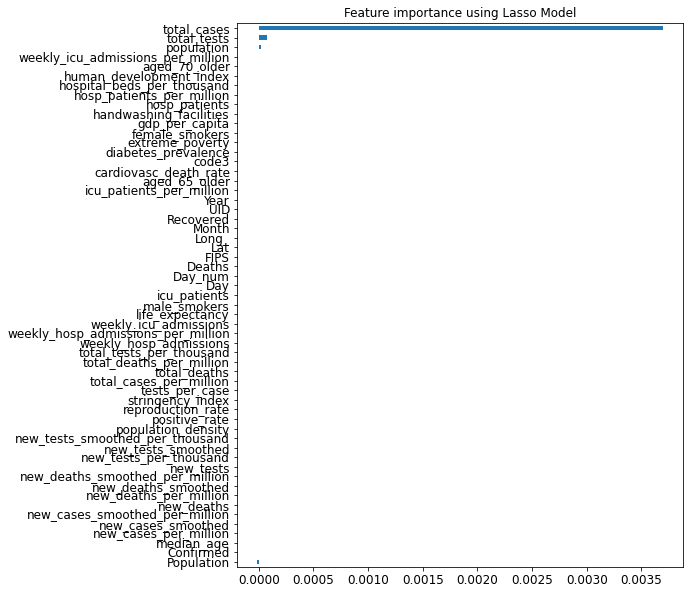

In [49]:
imp_coef = coef.sort_values()
import matplotlib
matplotlib.rcParams['figure.figsize'] = (8.0, 10.0)
imp_coef.plot(kind = "barh")
plt.title("Feature importance using Lasso Model")

# RFE

The Recursive Feature Elimination (RFE) method works by recursively removing attributes and building a model on those attributes that remain. It uses accuracy metric to rank the feature according to their importance. The RFE method takes the model to be used and the number of required features as input. It then gives the ranking of all the variables, 1 being most important. It also gives its support, True being relevant feature and False being irrelevant feature.

In [50]:
cols = list(X.columns)
model = LinearRegression()
#Initializing RFE model
rfe = RFE(model, 10)             
#Transforming data using RFE
X_rfe = rfe.fit_transform(X,y)  
#Fitting the data to model
model.fit(X_rfe,y)              
temp = pd.Series(rfe.support_,index = cols)
selected_features_rfe = temp[temp==True].index
print(selected_features_rfe)

Index(['Day', 'Day_num', 'Month', 'aged_65_older', 'aged_70_older',
       'hospital_beds_per_thousand', 'human_development_index',
       'new_deaths_smoothed_per_million', 'positive_rate',
       'reproduction_rate'],
      dtype='object')


In [51]:
#no of features
nof_list=np.arange(1,13)            
high_score=0
#Variable to store the optimum features
nof=0           
score_list =[]
for n in range(len(nof_list)):
    X_train, X_test, y_train, y_test = train_test_split(X.select_dtypes(['number']).fillna(0),y, test_size = 0.3, random_state = 0)
    model = LinearRegression()
    rfe = RFE(model,nof_list[n])
    X_train_rfe = rfe.fit_transform(X_train,y_train)
    X_test_rfe = rfe.transform(X_test)
    model.fit(X_train_rfe,y_train)
    score = model.score(X_test_rfe,y_test)
    score_list.append(score)
    if(score>high_score):
        high_score = score
        nof = nof_list[n]
print("Optimum number of features: %d" %nof)
print("Score with %d features: %f" % (nof, high_score))

Optimum number of features: 12
Score with 12 features: 0.830256


In [52]:
model = LinearRegression()
#Initializing RFE model
rfe = RFE(model, 7)
#Transforming data using RFE
X_rfe = rfe.fit_transform(X.select_dtypes(['number']).fillna(0),y)  
#Fitting the data to model
model.fit(X_rfe,y)
print(rfe.support_)
print(rfe.ranking_)

[False  True  True False False False False  True False False False False
 False False False False False False False False False False False False
  True False False False False False False False False False False False
  True False False False False False False  True  True False False False
 False False False False False False False False False]
[43  1  1 35 47 37 23  1 50 44 48 49  4  3 32 36 16 24 19 45 28 41 30  2
  1 29 12 11 22 21 13 15 10  9  7  8  1 33  6 34  5 51 39  1  1 18 40 42
 38 31 26 46 27 25 20 17 14]


After using different techniques to choose our features , the rfe and filter methods results were the more useful.
We got the following results to study new cases:

filter method:

total_cases               0.967114

new_cases                 1.000000

new_cases_smoothed        0.992472

total_deaths              0.965026

new_deaths                0.896174

new_deaths_smoothed       0.897997

icu_patients              0.808436

hosp_patients             0.833182

weekly_hosp_admissions    0.515664

total_tests               0.820575

new_tests                 0.890239

new_tests_smoothed        0.863084

population                0.721367

Confirmed                 0.850141

Recovered                 0.698644

Deaths                    0.790420

UID                       0.505488

RFE:

'Day_num',

'Month',

'aged_65_older',

'aged_70_older',

'human_development_index'
       
'icu_patients_per_million'
       
'life_expectancy'
       
'median_age'
       
'new_cases'
       
'new_tests_per_thousand


In [53]:
"""study_cases=all_data[['location','Day_num', 'Month','total_cases','new_cases','total_deaths','new_deaths','icu_patients',
                     'hosp_patients','weekly_hosp_admissions',
                     'population','Confirmed','Recovered','Deaths','UID','life_expectancy','positive_rate','reproduction_rate',
                      'median_age'
                    ]].copy()"""

"study_cases=all_data[['location','Day_num', 'Month','total_cases','new_cases','total_deaths','new_deaths','icu_patients',\n                     'hosp_patients','weekly_hosp_admissions',\n                     'population','Confirmed','Recovered','Deaths','UID','life_expectancy','positive_rate','reproduction_rate',\n                      'median_age'\n                    ]].copy()"

We selected our features 

In [54]:
study_cases=all_data[['location','Date','Day_num','new_cases','new_deaths',
                     'population','Confirmed','Recovered','UID','positive_rate'
                    ]].copy()

# Data cleaning

We cleaned our dataset by filling NaN values using the median value of each variable,
IT helped us to have a better accuracy than with 0

In [55]:
study_cases

,location,Date,Day_num,new_cases,new_deaths,population,Confirmed,Recovered,UID,positive_rate
0,Afghanistan,2020-01-23,22,0.0,0.0,38928341.0,0.0,0.0,4.0,NaN
1,Afghanistan,2020-01-24,23,0.0,0.0,38928341.0,0.0,0.0,4.0,NaN
2,Afghanistan,2020-01-25,24,0.0,0.0,38928341.0,0.0,0.0,4.0,NaN
3,Afghanistan,2020-01-26,25,0.0,0.0,38928341.0,0.0,0.0,4.0,NaN
4,Afghanistan,2020-01-27,26,0.0,0.0,38928341.0,0.0,0.0,4.0,NaN
...,...,...,...,...,...,...,...,...,...,...
60284,Zimbabwe,2020-11-28,332,108.0,0.0,14862927.0,9822.0,8472.0,716.0,0.078
60285,Zimbabwe,2020-11-29,333,0.0,0.0,14862927.0,9822.0,8472.0,716.0,0.076
60286,Zimbabwe,2020-11-30,334,128.0,1.0,14862927.0,9950.0,8482.0,716.0,0.079
60287,Zimbabwe,2020-12-01,335,179.0,1.0,14862927.0,10129.0,8643.0,716.0,NaN


In [56]:
study_cases.describe()

,Day_num,new_cases,new_deaths,population,Confirmed,Recovered,UID,positive_rate
count,60289.000000,60166.000000,60166.000000,5.997400e+04,5.576000e+04,5.576000e+04,5.579900e+04,25153.000000
mean,178.944302,2144.321378,49.616694,8.187314e+07,9.721074e+04,6.146908e+04,4.769889e+05,0.070842
std,91.033931,20410.447706,415.866967,5.807590e+08,5.748263e+05,3.841748e+05,6.257451e+06,0.090551
min,0.000000,-10034.000000,-1918.000000,8.090000e+02,0.000000e+00,0.000000e+00,4.000000e+00,0.000000
25%,100.000000,0.000000,0.000000,2.225728e+06,3.400000e+01,8.000000e+00,2.460000e+02,0.010000
50%,179.000000,13.000000,0.000000,9.449321e+06,1.857000e+03,8.580000e+02,4.780000e+02,0.035000
75%,258.000000,247.000000,4.000000,3.107294e+07,2.431125e+04,1.170800e+04,7.160000e+02,0.097000
max,336.000000,672046.000000,12782.000000,7.794799e+09,1.392191e+07,8.973373e+06,8.339118e+07,0.729000


In [57]:
study_cases.isnull().sum()

location             0
Date              4529
Day_num              0
new_cases          123
new_deaths         123
population         315
Confirmed         4529
Recovered         4529
UID               4490
positive_rate    35136
dtype: int64

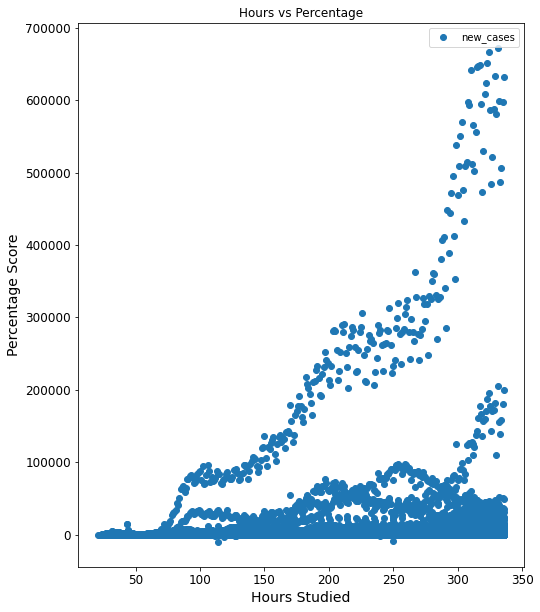

In [58]:
study_cases.plot(x='Day_num', y='new_cases', style='o')
plt.title('Hours vs Percentage')
plt.xlabel('Hours Studied')
plt.ylabel('Percentage Score')
plt.show()

In [59]:
study_cases=study_cases.fillna(study_cases.median())

In [60]:
study_cases

,location,Date,Day_num,new_cases,new_deaths,population,Confirmed,Recovered,UID,positive_rate
0,Afghanistan,2020-01-23,22,0.0,0.0,38928341.0,0.0,0.0,4.0,0.035
1,Afghanistan,2020-01-24,23,0.0,0.0,38928341.0,0.0,0.0,4.0,0.035
2,Afghanistan,2020-01-25,24,0.0,0.0,38928341.0,0.0,0.0,4.0,0.035
3,Afghanistan,2020-01-26,25,0.0,0.0,38928341.0,0.0,0.0,4.0,0.035
4,Afghanistan,2020-01-27,26,0.0,0.0,38928341.0,0.0,0.0,4.0,0.035
...,...,...,...,...,...,...,...,...,...,...
60284,Zimbabwe,2020-11-28,332,108.0,0.0,14862927.0,9822.0,8472.0,716.0,0.078
60285,Zimbabwe,2020-11-29,333,0.0,0.0,14862927.0,9822.0,8472.0,716.0,0.076
60286,Zimbabwe,2020-11-30,334,128.0,1.0,14862927.0,9950.0,8482.0,716.0,0.079
60287,Zimbabwe,2020-12-01,335,179.0,1.0,14862927.0,10129.0,8643.0,716.0,0.035


In [61]:
france=study_cases[study_cases['location']=='France']
france

,location,Date,Day_num,new_cases,new_deaths,population,Confirmed,Recovered,UID,positive_rate
18586,France,2020-01-23,22,0.0,0.0,65273512.0,0.0,0.0,479.833333,0.035
18587,France,2020-01-24,23,2.0,0.0,65273512.0,2.0,0.0,479.833333,0.035
18588,France,2020-01-25,24,1.0,0.0,65273512.0,3.0,0.0,479.833333,0.035
18589,France,2020-01-26,25,0.0,0.0,65273512.0,3.0,0.0,479.833333,0.035
18590,France,2020-01-27,26,0.0,0.0,65273512.0,3.0,0.0,479.833333,0.035
...,...,...,...,...,...,...,...,...,...,...
18896,France,2020-11-28,332,12580.0,213.0,65273512.0,2260789.0,166715.0,479.833333,0.035
18897,France,2020-11-29,333,9784.0,198.0,65273512.0,2270573.0,167005.0,479.833333,0.035
18898,France,2020-11-30,334,4443.0,409.0,65273512.0,2274902.0,167913.0,479.833333,0.035
18899,France,2020-12-01,335,413.0,2.0,65273512.0,2283172.0,169663.0,479.833333,0.035


In [62]:
spain=study_cases[study_cases['location']=='Spain']
spain

,location,Date,Day_num,new_cases,new_deaths,population,Confirmed,Recovered,UID,positive_rate
49866,Spain,2020-01-23,22,0.0,0.0,46754783.0,0.0,0.0,68996.857143,0.035
49867,Spain,2020-01-24,23,0.0,0.0,46754783.0,0.0,0.0,68996.857143,0.035
49868,Spain,2020-01-25,24,0.0,0.0,46754783.0,0.0,0.0,68996.857143,0.035
49869,Spain,2020-01-26,25,0.0,0.0,46754783.0,0.0,0.0,68996.857143,0.035
49870,Spain,2020-01-27,26,0.0,0.0,46754783.0,0.0,0.0,68996.857143,0.035
...,...,...,...,...,...,...,...,...,...,...
50176,Spain,2020-11-28,332,0.0,0.0,46754783.0,1628208.0,150376.0,68996.857143,0.035
50177,Spain,2020-11-29,333,0.0,0.0,46754783.0,1628208.0,150376.0,68996.857143,0.035
50178,Spain,2020-11-30,334,19979.0,401.0,46754783.0,1648187.0,150376.0,68996.857143,0.035
50179,Spain,2020-12-01,335,8257.0,442.0,46754783.0,1656444.0,150376.0,68996.857143,0.035


In [63]:
Italy=study_cases[study_cases['location']=='Italy']
Italy

,location,Date,Day_num,new_cases,new_deaths,population,Confirmed,Recovered,UID,positive_rate
25901,Italy,2020-01-23,22,0.0,0.0,60461828.0,0.0,0.0,36303.136364,0.035
25902,Italy,2020-01-24,23,0.0,0.0,60461828.0,0.0,0.0,36303.136364,0.035
25903,Italy,2020-01-25,24,0.0,0.0,60461828.0,0.0,0.0,36303.136364,0.035
25904,Italy,2020-01-26,25,0.0,0.0,60461828.0,0.0,0.0,36303.136364,0.035
25905,Italy,2020-01-27,26,0.0,0.0,60461828.0,0.0,0.0,36303.136364,0.035
...,...,...,...,...,...,...,...,...,...,...
26211,Italy,2020-11-28,332,26315.0,686.0,60461828.0,1564532.0,720861.0,36303.136364,0.128
26212,Italy,2020-11-29,333,20646.0,541.0,60461828.0,1585178.0,734503.0,36303.136364,0.124
26213,Italy,2020-11-30,334,16376.0,672.0,60461828.0,1601554.0,757507.0,36303.136364,0.121
26214,Italy,2020-12-01,335,19347.0,785.0,60461828.0,1620901.0,784595.0,36303.136364,0.118


In [64]:
US=study_cases[study_cases['location']=='US']
US

,location,Date,Day_num,new_cases,new_deaths,population,Confirmed,Recovered,UID,positive_rate
56507,US,2020-01-22,21,13.0,0.0,331002647.0,1.0,0.0,8.339118e+07,0.035
56508,US,2020-01-23,22,0.0,0.0,331002647.0,1.0,0.0,8.339118e+07,0.035
56509,US,2020-01-24,23,1.0,0.0,331002647.0,2.0,0.0,8.339118e+07,0.035
56510,US,2020-01-25,24,0.0,0.0,331002647.0,2.0,0.0,8.339118e+07,0.035
56511,US,2020-01-26,25,3.0,0.0,331002647.0,5.0,0.0,8.339118e+07,0.035
...,...,...,...,...,...,...,...,...,...,...
56818,US,2020-11-28,332,155866.0,1189.0,331002647.0,13244701.0,5023063.0,8.339118e+07,0.131
56819,US,2020-11-29,333,138633.0,826.0,331002647.0,13383370.0,5065030.0,8.339118e+07,0.035
56820,US,2020-11-30,334,157901.0,1172.0,331002647.0,13541221.0,5146319.0,8.339118e+07,0.035
56821,US,2020-12-01,335,180083.0,2597.0,331002647.0,13721858.0,5226581.0,8.339118e+07,0.035


In [65]:
China=study_cases[study_cases['location']=='China']
China

,location,Date,Day_num,new_cases,new_deaths,population,Confirmed,Recovered,UID,positive_rate
11025,China,2020-01-22,21,13.0,0.0,1.439324e+09,548.0,28.0,14265.941176,0.035
11026,China,2020-01-23,22,95.0,1.0,1.439324e+09,643.0,30.0,14265.941176,0.035
11027,China,2020-01-24,23,277.0,8.0,1.439324e+09,920.0,36.0,14265.941176,0.035
11028,China,2020-01-25,24,486.0,16.0,1.439324e+09,1406.0,39.0,14265.941176,0.035
11029,China,2020-01-26,25,669.0,14.0,1.439324e+09,2075.0,49.0,14265.941176,0.035
...,...,...,...,...,...,...,...,...,...,...
11336,China,2020-11-28,332,95.0,1.0,1.439324e+09,92681.0,86968.0,14265.941176,0.035
11337,China,2020-11-29,333,133.0,0.0,1.439324e+09,92814.0,86998.0,14265.941176,0.035
11338,China,2020-11-30,334,88.0,0.0,1.439324e+09,92902.0,87017.0,14265.941176,0.035
11339,China,2020-12-01,335,91.0,0.0,1.439324e+09,92993.0,87051.0,14265.941176,0.035


In [66]:
X = study_cases[study_cases.columns.difference(['new_cases'])].fillna(study_cases.median())
y = study_cases['new_cases'].fillna(study_cases.median())
X=X.select_dtypes(['number']).fillna(X.median())
y=y.fillna(y.median())

In [67]:
Xfrance = france[france.columns.difference(['new_cases'])].fillna(france.median())
yfrance = france['new_cases'].fillna(france.median())
Xfrance=Xfrance.select_dtypes(['number']).fillna(Xfrance.median())
yfrance=yfrance.fillna(yfrance.median())

In [68]:
XItaly = Italy[Italy.columns.difference(['new_cases'])].fillna(Italy.median())
yItaly = Italy['new_cases'].fillna(Italy.median())
XItaly=XItaly.select_dtypes(['number']).fillna(XItaly.median())
yItaly=yItaly.fillna(yItaly.median())

In [69]:
XUS = US[US.columns.difference(['new_cases'])].fillna(US.median())
yUS = US['new_cases'].fillna(US.median())
XUS=XUS.select_dtypes(['number']).fillna(XUS.median())
yUS=yUS.fillna(yUS.median())

In [70]:
XChina = China[China.columns.difference(['new_cases'])].fillna(China.median())
yChina = China['new_cases'].fillna(China.median())
XChina=XChina.select_dtypes(['number']).fillna(XChina.median())
yChina=yChina.fillna(yChina.median())

In [71]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

Since we are using trees based model we don't need to standarize our data

We used the linear regression on the dataset to try to predict the new cases in the world then in specific countries

# Linear regression

The term "linearity" in algebra refers to a linear relationship between two or more variables. If we draw this relationship in a two dimensional space (between two variables, in this case), we get a straight line.

Let's consider a scenario where we want to determine the linear relationship between the numbers of hours a student studies and the percentage of marks that student scores in an exam. We want to find out that given the number of hours a student prepares for a test, about how high of a score can the student achieve? If we plot the independent variable (hours) on the x-axis and dependent variable (percentage) on the y-axis, linear regression gives us a straight line that best fits the data points, as shown in the figure below.

Study hours and test scores plot
We know that the equation of a straight line is basically:

y = mx + b
Where b is the intercept and m is the slope of the line. So basically, the linear regression algorithm gives us the most optimal value for the intercept and the slope (in two dimensions). The y and x variables remain the same, since they are the data features and cannot be changed. The values that we can control are the intercept and slope. There can be multiple straight lines depending upon the values of intercept and slope. Basically what the linear regression algorithm does is it fits multiple lines on the data points and returns the line that results in the least error.

This same concept can be extended to the cases where there are more than two variables. This is called multiple linear regression. For instance, consider a scenario where you have to predict the price of house based upon its area, number of bedrooms, average income of the people in the area, the age of the house, and so on. In this case the dependent variable is dependent upon several independent variables. A regression model involving multiple variables can be represented as:

    

        y = b0 + m1b1 + m2b2 + m3b3 + ... ... mnbn
    

This is the equation of a hyper plane. Remember, a linear regression model in two dimensions is a straight line; in three dimensions it is a plane, and in more than three dimensions, a hyper plane.

# Evaluating the Algorithm
The final step is to evaluate the performance of algorithm. This step is particularly important to compare how well different algorithms perform on a particular dataset. For regression algorithms, three evaluation metrics are commonly used:

Mean Absolute Error (MAE) is the mean of the absolute value of the errors. It is calculated as:
Mean Absolute Error
Mean Squared Error (MSE) is the mean of the squared errors and is calculated as:
Mean Squared Error
Root Mean Squared Error (RMSE) is the square root of the mean of the squared errors:
Root Mean Squared Error
Luckily, we don't have to perform these calculations manually. The Scikit-Learn library comes with pre-built functions that can be used to find out these values for us

In [72]:
from sklearn.linear_model import LinearRegression
regressor = LinearRegression()
regressor.fit(X_train, y_train)
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
display(coeff_df)
y_pred = regressor.predict(X_test)
df = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred})
display(df)
from sklearn import metrics
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

,Coefficient
Confirmed,1.081342e-02
Day_num,4.918088e+00
Recovered,-9.728782e-03
UID,-2.399503e-04
new_deaths,4.196308e+01
population,8.049899e-07
positive_rate,-8.177039e+03


,Actual,Predicted
18473,19.0,305.570815
32902,0.0,-443.433397
18235,0.0,682.887061
10423,0.0,-825.281112
57269,58.0,-292.801994
...,...,...
51255,2.0,-329.188892
29485,7.0,-382.497387
10211,0.0,-316.715063
53580,2.0,459.759601


Mean Absolute Error: 1553.8636910004648
Mean Squared Error: 93832826.05694984
Root Mean Squared Error: 9686.73454043982


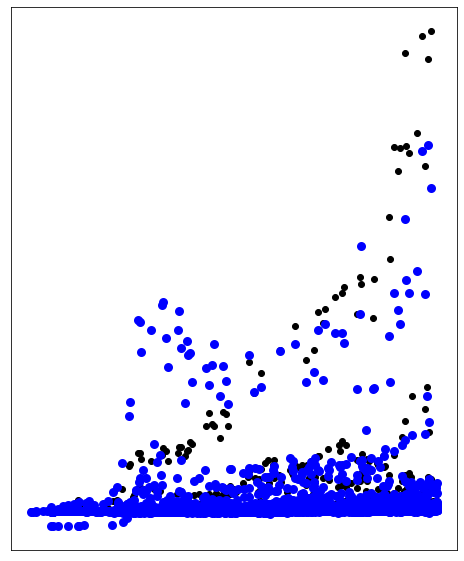

In [73]:
plt.scatter(X_test['Day_num'], y_test,  color='black')
plt.scatter(X_test['Day_num'], y_pred, color='blue', linewidth=3)

plt.xticks(())
plt.yticks(())

plt.show()

In [74]:
X_train, X_test, y_train, y_test = train_test_split(XItaly, yItaly, test_size=0.2, random_state=0)
regressor.fit(X_train, y_train)
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
display(coeff_df)
y_pred = regressor.predict(X_test)
df = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred})
display(df)
from sklearn import metrics
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

,Coefficient
Confirmed,6.227466e-02
Day_num,6.466175e+01
Recovered,-1.216353e-01
UID,4.263256e-13
new_deaths,-9.338256e+00
population,0.000000e+00
positive_rate,2.857517e+04


,Actual,Predicted
25966,5974.0,2190.797665
26215,20709.0,13379.906684
26051,224.0,-1425.083251
26059,126.0,-1357.166942
26009,802.0,3241.614198
...,...,...
26182,31079.0,22247.600451
26076,230.0,-1040.675464
25906,0.0,-2297.281472
25934,93.0,-494.836411


Mean Absolute Error: 2059.0552307693165
Mean Squared Error: 7337351.620268534
Root Mean Squared Error: 2708.754625334036


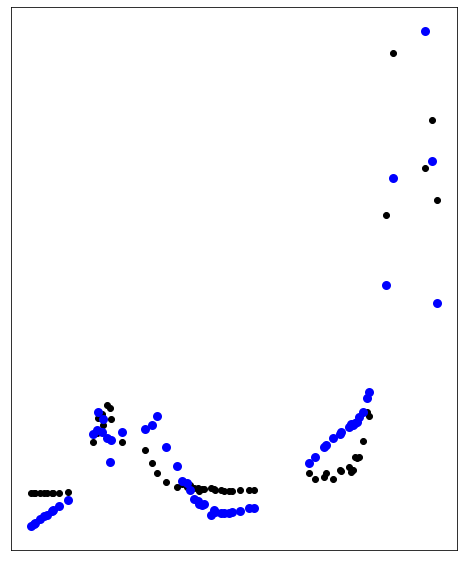

In [75]:
plt.scatter(X_test['Day_num'], y_test,  color='black')
plt.scatter(X_test['Day_num'], y_pred, color='blue', linewidth=3)

plt.xticks(())
plt.yticks(())

plt.show()

In [76]:
X_train, X_test, y_train, y_test = train_test_split(Xfrance, yfrance, test_size=0.2, random_state=0)
regressor.fit(X_train, y_train)
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
display(coeff_df)
y_pred = regressor.predict(X_test)
df = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred})
display(df)
from sklearn import metrics
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

,Coefficient
Confirmed,-5.732432e-03
Day_num,-2.139878e-02
Recovered,6.091260e-02
UID,7.776180e-11
new_deaths,4.533839e+00
population,0.000000e+00
positive_rate,2.449182e+05


,Actual,Predicted
18651,4703.0,1901.357095
18900,248.0,-2422.090012
18736,284.0,-898.417445
18744,2046.0,-1184.587983
18694,312.0,3052.592676
...,...,...
18867,49495.0,45695.634322
18761,534.0,-1376.870304
18591,1.0,321.560320
18619,2.0,321.573868


Mean Absolute Error: 4657.040993261483
Mean Squared Error: 72854645.05643815
Root Mean Squared Error: 8535.493252087905


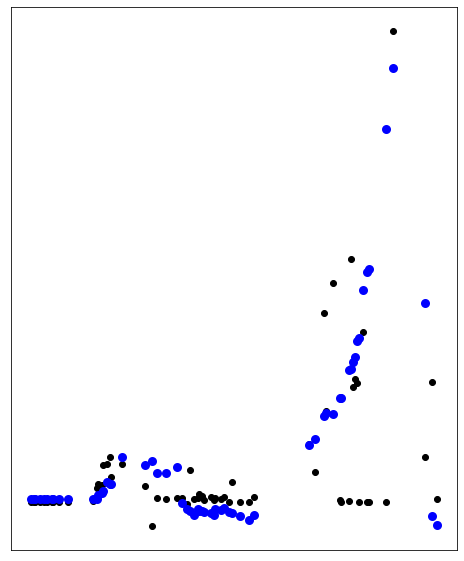

In [77]:
plt.scatter(X_test['Day_num'], y_test,  color='black')
plt.scatter(X_test['Day_num'], y_pred, color='blue', linewidth=3)

plt.xticks(())
plt.yticks(())

plt.show()

In [78]:
X_train, X_test, y_train, y_test = train_test_split(XUS, yUS, test_size=0.2, random_state=0)
regressor.fit(X_train, y_train)
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
display(coeff_df)
y_pred = regressor.predict(X_test)
df = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred})
display(df)
from sklearn import metrics
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

,Coefficient
Confirmed,5.740132e-02
Day_num,-4.082529e+02
Recovered,-9.498008e-02
UID,1.233502e-11
new_deaths,-7.907770e-01
population,0.000000e+00
positive_rate,2.236525e+05


,Actual,Predicted
56641,21368.0,17064.841022
56794,102873.0,91948.966408
56562,1833.0,-9268.215028
56761,54402.0,54435.856261
56783,82787.0,70167.089178
...,...,...
56573,19607.0,11026.697840
56610,23382.0,31011.302909
56716,45037.0,62341.696086
56721,34457.0,62251.243507


Mean Absolute Error: 10628.323761082142
Mean Squared Error: 189185885.42779386
Root Mean Squared Error: 13754.486011036322


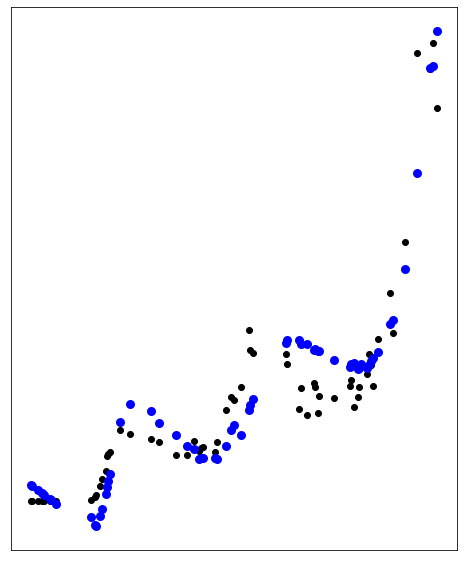

In [79]:
plt.scatter(X_test['Day_num'], y_test,  color='black')
plt.scatter(X_test['Day_num'], y_pred, color='blue', linewidth=3)

plt.xticks(())
plt.yticks(())

plt.show()

In [80]:
X_train, X_test, y_train, y_test = train_test_split(XChina, yChina, test_size=0.2, random_state=0)
regressor.fit(X_train, y_train)
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
display(coeff_df)
y_pred = regressor.predict(X_test)
df = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred})
display(df)
from sklearn import metrics
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

,Coefficient
Confirmed,1.947846e-03
Day_num,2.043324e+00
Recovered,-2.807658e-02
UID,-1.103805e-28
new_deaths,8.830711e-01
population,0.000000e+00
positive_rate,2.451476e-31


,Actual,Predicted
11159,11.0,-33.138045
11312,31.0,103.016150
11080,25.0,108.944661
11279,17.0,53.874839
11301,20.0,86.410834
...,...,...
11091,102.0,-52.515145
11128,2.0,-79.388684
11234,53.0,20.135997
11239,41.0,12.693577


Mean Absolute Error: 354.1397785271003
Mean Squared Error: 2827618.445328126
Root Mean Squared Error: 1681.55239149071


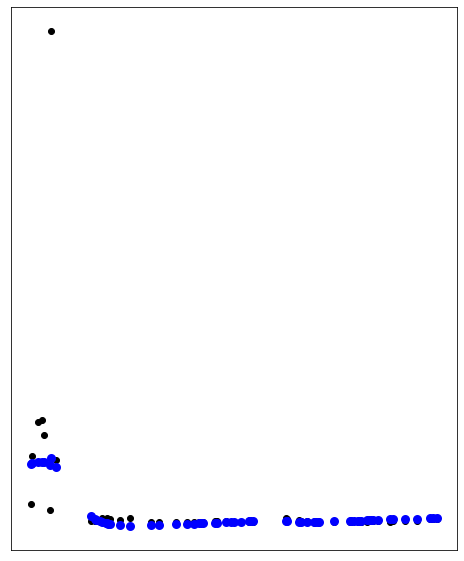

In [81]:
plt.scatter(X_test['Day_num'], y_test,  color='black')
plt.scatter(X_test['Day_num'], y_pred, color='blue', linewidth=3)

plt.xticks(())
plt.yticks(())

plt.show()

# Decision Tree

A decision tree is one of most frequently and widely used supervised machine learning algorithms that can perform both regression and classification tasks. The intuition behind the decision tree algorithm is simple, yet also very powerful.

For each attribute in the dataset, the decision tree algorithm forms a node, where the most important attribute is placed at the root node. For evaluation we start at the root node and work our way down the tree by following the corresponding node that meets our condition or "decision". This process continues until a leaf node is reached, which contains the prediction or the outcome of the decision tree.

We are focusing on decision tree regression only. So, decision tree regression is used for the continuous output problem. Continuous output means the output of the result is not discrete, i.e., it is not represented just by a discrete, known set of numbers or values. Decision tree regression observes features of an object and trains a model in the structure of a tree to predict data in the future to produce meaningful continuous output.

# Decision tree of the world

In [82]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

In [83]:
from sklearn.tree import DecisionTreeClassifier
classifier = DecisionTreeClassifier()
classifier.fit(X_train, y_train)

DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=None,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=None, splitter='best')

In [84]:
y_pred = classifier.predict(X_test)


In [85]:
from sklearn.metrics import classification_report, confusion_matrix
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 1 0 0]
 [0 0 0 ... 0 0 0]]
              precision    recall  f1-score   support

     -7953.0       0.00      0.00      0.00         0
     -1480.0       0.00      0.00      0.00         0
      -719.0       0.00      0.00      0.00         1
      -148.0       0.00      0.00      0.00         1
      -110.0       0.00      0.00      0.00         1
      -104.0       0.00      0.00      0.00         0
      -100.0       0.00      0.00      0.00         1
       -42.0       0.00      0.00      0.00         0
       -17.0       0.00      0.00      0.00         1
       -15.0       0.00      0.00      0.00         1
        -9.0       0.00      0.00      0.00         0
        -6.0       0.00      0.00      0.00         0
        -4.0       0.00      0.00      0.00         0
        -1.0       0.00      0.00      0.00         1
         0.0       0.83      0.84      0.84      4162
         1.0   

In [86]:
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
coeff_df

,Coefficient
Confirmed,1.947846e-03
Day_num,2.043324e+00
Recovered,-2.807658e-02
UID,-1.103805e-28
new_deaths,8.830711e-01
population,0.000000e+00
positive_rate,2.451476e-31


In [87]:
df=pd.DataFrame({'Actual':y_test, 'Predicted':y_pred})
df

,Actual,Predicted
18473,19.0,41.0
32902,0.0,0.0
18235,0.0,0.0
10423,0.0,0.0
57269,58.0,79.0
...,...,...
51255,2.0,4.0
29485,7.0,23.0
10211,0.0,104.0
53580,2.0,8.0


In [88]:
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 402.51053242660475
Mean Squared Error: 14134339.999834135
Root Mean Squared Error: 3759.566464345874


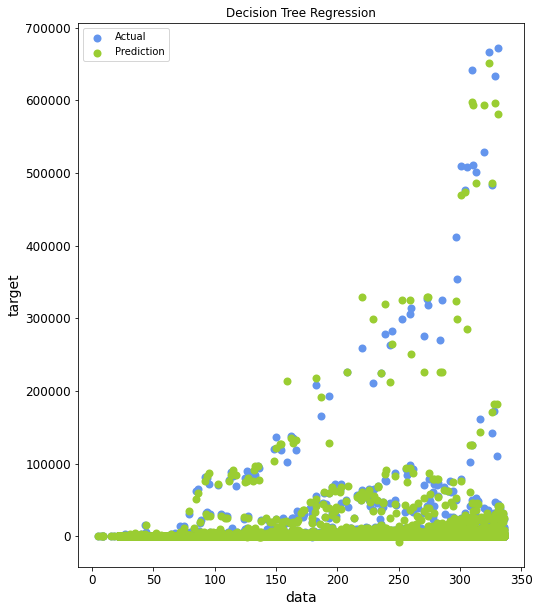

In [89]:
plt.figure()
plt.scatter(X_test['Day_num'], y_test, color="cornflowerblue",
         label="Actual", linewidth=2)
plt.scatter(X_test['Day_num'], y_pred, color="yellowgreen", label="Prediction", linewidth=2)
plt.xlabel("data")
plt.ylabel("target")
plt.title("Decision Tree Regression")
plt.legend()
plt.show()

In [90]:

clf = DecisionTreeClassifier(max_depth = 3, 
                             random_state = 0)
clf.fit(X_train, y_train)


DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=3,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=0, splitter='best')

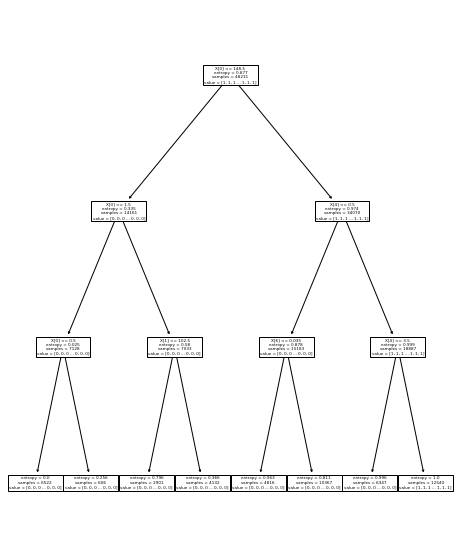

In [91]:
tree.plot_tree(clf);


In [92]:
acc_decision_tree = round(clf.score(X_train, y_train) * 100, 2)
acc_decision_tree

34.65

# Study of specific countries

# France

In [93]:
X_train, X_test, y_train, y_test = train_test_split(Xfrance, yfrance, test_size=0.2, random_state=0)


In [94]:
classifier = DecisionTreeClassifier()
classifier.fit(X_train, y_train)
y_pred = classifier.predict(X_test)
from sklearn.metrics import classification_report, confusion_matrix
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 1 0]]
              precision    recall  f1-score   support

     -2510.0       0.00      0.00      0.00         1
      -766.0       0.00      0.00      0.00         0
      -719.0       0.00      0.00      0.00         0
      -220.0       0.00      0.00      0.00         1
         0.0       0.88      0.47      0.61        15
         1.0       0.00      0.00      0.00         1
         2.0       0.00      0.00      0.00         1
         5.0       0.00      0.00      0.00         0
        15.0       0.00      0.00      0.00         0
        19.0       0.00      0.00      0.00         0
        20.0       0.00      0.00      0.00         0
        25.0       0.00      0.00      0.00         1
        33.0       0.00      0.00      0.00         1
        36.0       0.00      0.00      0.00         1
        62.0       0.00      0.00      0.00         0
        78.0   

In [95]:
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
coeff_df

,Coefficient
Confirmed,1.947846e-03
Day_num,2.043324e+00
Recovered,-2.807658e-02
UID,-1.103805e-28
new_deaths,8.830711e-01
population,0.000000e+00
positive_rate,2.451476e-31


In [96]:
df=pd.DataFrame({'Actual':y_test, 'Predicted':y_pred})
df

,Actual,Predicted
18651,4703.0,3851.0
18900,248.0,82.0
18736,284.0,407.0
18744,2046.0,541.0
18694,312.0,580.0
...,...,...
18867,49495.0,47637.0
18761,534.0,928.0
18591,1.0,0.0
18619,2.0,20.0


In [97]:
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 1821.7936507936508
Mean Squared Error: 18996487.73015873
Root Mean Squared Error: 4358.496039938402


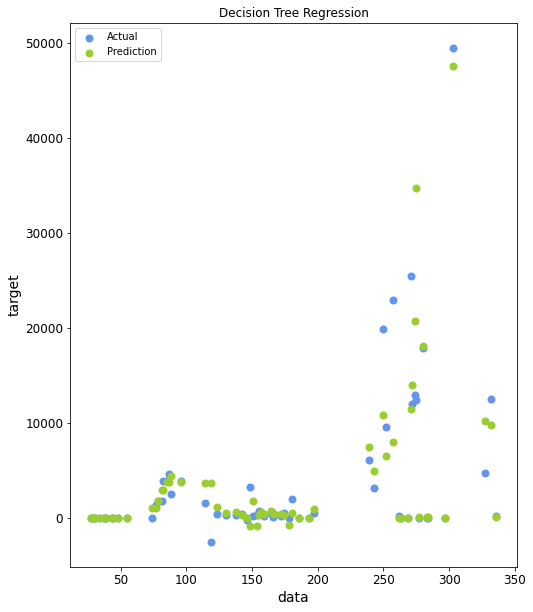

In [98]:
plt.figure()
plt.scatter(X_test['Day_num'], y_test, color="cornflowerblue",
         label="Actual", linewidth=2)
plt.scatter(X_test['Day_num'], y_pred, color="yellowgreen", label="Prediction", linewidth=2)
plt.xlabel("data")
plt.ylabel("target")
plt.title("Decision Tree Regression")
plt.legend()
plt.show()

In [99]:

clf = DecisionTreeClassifier(max_depth = 3, 
                             random_state = 0)
clf.fit(X_train, y_train)


DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=3,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=0, splitter='best')

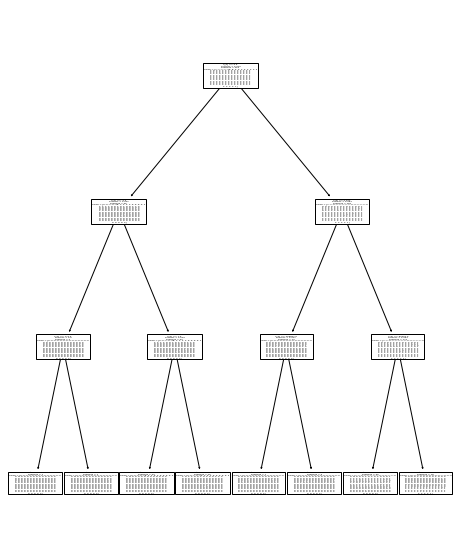

In [100]:
tree.plot_tree(clf);


In [101]:
acc_decision_tree = round(clf.score(X_train, y_train) * 100, 2)
acc_decision_tree

18.25

# China

In [102]:
X_train, X_test, y_train, y_test = train_test_split(XChina, yChina, test_size=0.2, random_state=0)


In [103]:
classifier = DecisionTreeClassifier()
classifier.fit(X_train, y_train)
y_pred = classifier.predict(X_test)
from sklearn.metrics import classification_report, confusion_matrix
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 1 0]]
              precision    recall  f1-score   support

        -1.0       0.00      0.00      0.00         1
         0.0       0.00      0.00      0.00         2
         2.0       0.00      0.00      0.00         1
         4.0       0.00      0.00      0.00         0
         5.0       0.00      0.00      0.00         1
         6.0       0.00      0.00      0.00         0
         7.0       0.00      0.00      0.00         1
         9.0       0.00      0.00      0.00         1
        10.0       0.00      0.00      0.00         1
        11.0       0.00      0.00      0.00         1
        14.0       0.00      0.00      0.00         0
        15.0       0.50      1.00      0.67         1
        17.0       0.00      0.00      0.00         3
        18.0       0.00      0.00      0.00         1
        19.0       0.00      0.00      0.00         3
        20.0   

In [104]:
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
coeff_df

,Coefficient
Confirmed,1.947846e-03
Day_num,2.043324e+00
Recovered,-2.807658e-02
UID,-1.103805e-28
new_deaths,8.830711e-01
population,0.000000e+00
positive_rate,2.451476e-31


In [105]:
df=pd.DataFrame({'Actual':y_test, 'Predicted':y_pred})
df

,Actual,Predicted
11159,11.0,6.0
11312,31.0,43.0
11080,25.0,30.0
11279,17.0,20.0
11301,20.0,35.0
...,...,...
11091,102.0,81.0
11128,2.0,5.0
11234,53.0,40.0
11239,41.0,23.0


In [106]:
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 218.640625
Mean Squared Error: 1243881.640625
Root Mean Squared Error: 1115.2944188083252


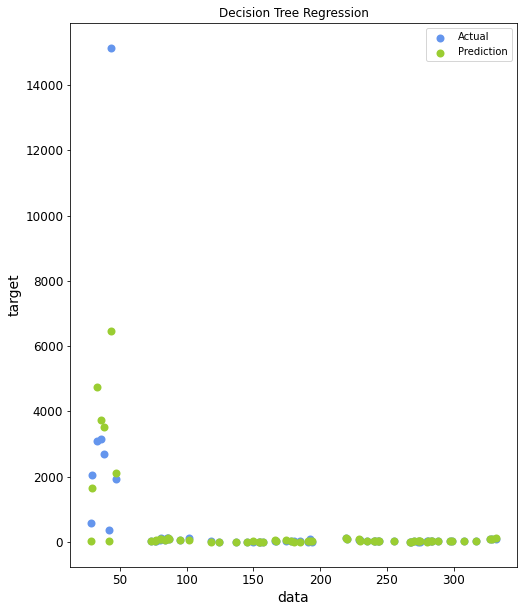

In [107]:
plt.figure()
plt.scatter(X_test['Day_num'], y_test, color="cornflowerblue", label="Actual", linewidth=2)
plt.scatter(X_test['Day_num'], y_pred, color="yellowgreen", label="Prediction", linewidth=2)
plt.xlabel("data")
plt.ylabel("target")
plt.title("Decision Tree Regression")
plt.legend()
plt.show()

In [108]:
clf = DecisionTreeClassifier(max_depth = 3,random_state = 0)
clf.fit(X_train, y_train)

DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=3,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=0, splitter='best')

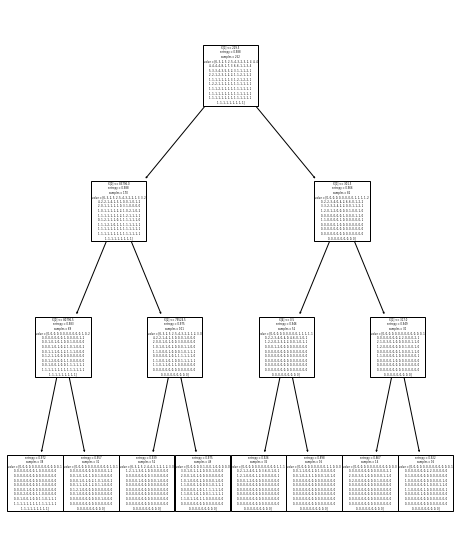

In [109]:
tree.plot_tree(clf);

In [110]:
acc_decision_tree = round(clf.score(X_train, y_train) * 100, 2)
acc_decision_tree

10.71

# US

In [111]:
X_train, X_test, y_train, y_test = train_test_split(XUS, yUS, test_size=0.2, random_state=0)


In [112]:
classifier = DecisionTreeClassifier()
classifier.fit(X_train, y_train)
y_pred = classifier.predict(X_test)
from sklearn.metrics import classification_report, confusion_matrix
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

[[3 1 0 ... 0 0 0]
 [3 0 0 ... 0 0 0]
 [1 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
              precision    recall  f1-score   support

         0.0       0.43      0.75      0.55         4
         1.0       0.00      0.00      0.00         3
         3.0       0.00      0.00      0.00         1
       633.0       0.00      0.00      0.00         0
       759.0       0.00      0.00      0.00         1
      1467.0       0.00      0.00      0.00         0
      1833.0       0.00      0.00      0.00         1
      2657.0       0.00      0.00      0.00         1
      5995.0       0.00      0.00      0.00         1
      6367.0       0.00      0.00      0.00         0
      8830.0       0.00      0.00      0.00         1
     10612.0       0.00      0.00      0.00         0
     11231.0       0.00      0.00      0.00         0
     12075.0       0.00      0.00      0.00         1
     17492.0       0.00      0.00      0.00         0
     17840.0   

In [113]:
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
coeff_df

,Coefficient
Confirmed,1.947846e-03
Day_num,2.043324e+00
Recovered,-2.807658e-02
UID,-1.103805e-28
new_deaths,8.830711e-01
population,0.000000e+00
positive_rate,2.451476e-31


In [114]:
df=pd.DataFrame({'Actual':y_test, 'Predicted':y_pred})
df

,Actual,Predicted
56641,21368.0,31917.0
56794,102873.0,124618.0
56562,1833.0,1467.0
56761,54402.0,55994.0
56783,82787.0,80987.0
...,...,...
56573,19607.0,18879.0
56610,23382.0,24457.0
56716,45037.0,47371.0
56721,34457.0,60716.0


In [115]:
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 8387.578125
Mean Squared Error: 239313305.390625
Root Mean Squared Error: 15469.754535564713


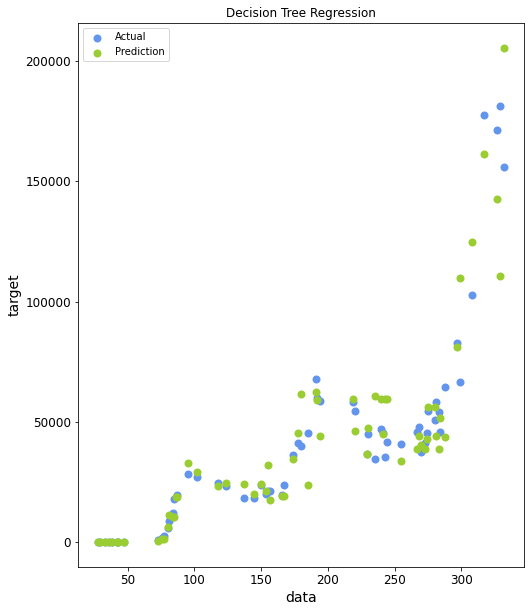

In [116]:
plt.figure()
plt.scatter(X_test['Day_num'], y_test, color="cornflowerblue", label="Actual", linewidth=2)
plt.scatter(X_test['Day_num'], y_pred, color="yellowgreen", label="Prediction", linewidth=2)
plt.xlabel("data")
plt.ylabel("target")
plt.title("Decision Tree Regression")
plt.legend()
plt.show()

In [117]:
clf = DecisionTreeClassifier(max_depth = 3,random_state = 0)
clf.fit(X_train, y_train)

DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=3,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=0, splitter='best')

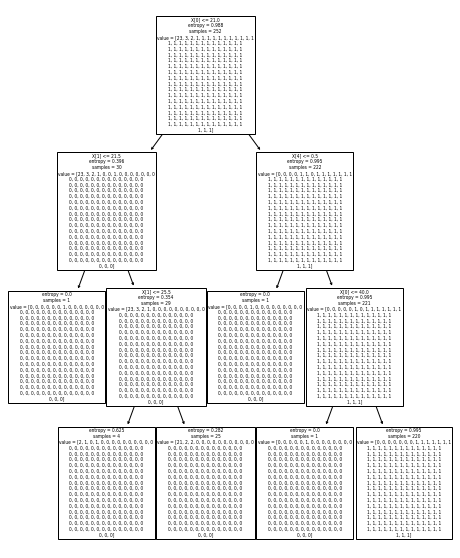

In [118]:
tree.plot_tree(clf);

In [119]:
acc_decision_tree = round(clf.score(X_train, y_train) * 100, 2)
acc_decision_tree

10.71

# italy

In [120]:
X_train, X_test, y_train, y_test = train_test_split(XItaly, yItaly, test_size=0.2, random_state=0)


In [121]:
classifier = DecisionTreeClassifier()
classifier.fit(X_train, y_train)
y_pred = classifier.predict(X_test)
from sklearn.metrics import classification_report, confusion_matrix
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

[[7 0 0 ... 0 0 0]
 [1 0 0 ... 0 0 0]
 [1 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
              precision    recall  f1-score   support

         0.0       0.78      1.00      0.88         7
         1.0       0.00      0.00      0.00         1
         2.0       0.00      0.00      0.00         1
        74.0       0.00      0.00      0.00         0
        93.0       0.00      0.00      0.00         1
       113.0       0.00      0.00      0.00         1
       114.0       0.00      0.00      0.00         0
       126.0       0.00      0.00      0.00         1
       175.0       0.00      0.00      0.00         1
       177.0       0.00      0.00      0.00         1
       188.0       0.00      0.00      0.00         0
       192.0       0.00      0.00      0.00         1
       197.0       0.00      0.00      0.00         0
       200.0       0.00      0.00      0.00         0
       208.0       0.00      0.00      0.00         0
       210.0   

In [122]:
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
coeff_df

,Coefficient
Confirmed,1.947846e-03
Day_num,2.043324e+00
Recovered,-2.807658e-02
UID,-1.103805e-28
new_deaths,8.830711e-01
population,0.000000e+00
positive_rate,2.451476e-31


In [123]:
df=pd.DataFrame({'Actual':y_test, 'Predicted':y_pred})
df

,Actual,Predicted
25966,5974.0,5909.0
26215,20709.0,1900.0
26051,224.0,264.0
26059,126.0,188.0
26009,802.0,744.0
...,...,...
26182,31079.0,24988.0
26076,230.0,114.0
25906,0.0,0.0
25934,93.0,74.0


In [124]:
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 1068.7142857142858
Mean Squared Error: 9636163.603174603
Root Mean Squared Error: 3104.217067663697


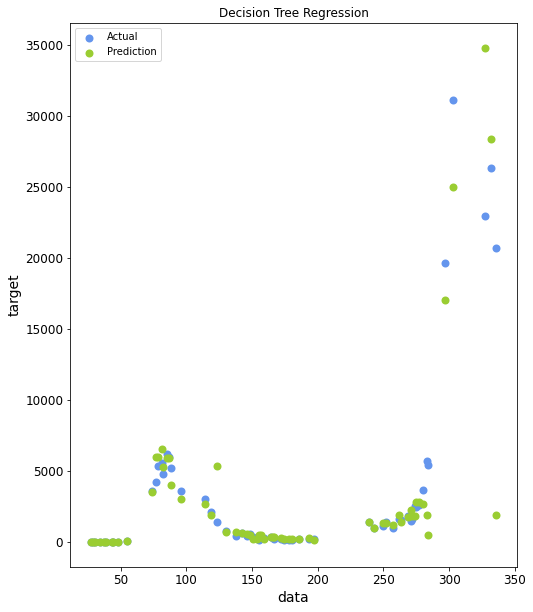

In [125]:
plt.figure()
plt.scatter(X_test['Day_num'], y_test, color="cornflowerblue", label="Actual", linewidth=2)
plt.scatter(X_test['Day_num'], y_pred, color="yellowgreen", label="Prediction", linewidth=2)
plt.xlabel("data")
plt.ylabel("target")
plt.title("Decision Tree Regression")
plt.legend()
plt.show()

In [126]:
clf = DecisionTreeClassifier(max_depth = 3,random_state = 0)
clf.fit(X_train, y_train)

DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=3,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=0, splitter='best')

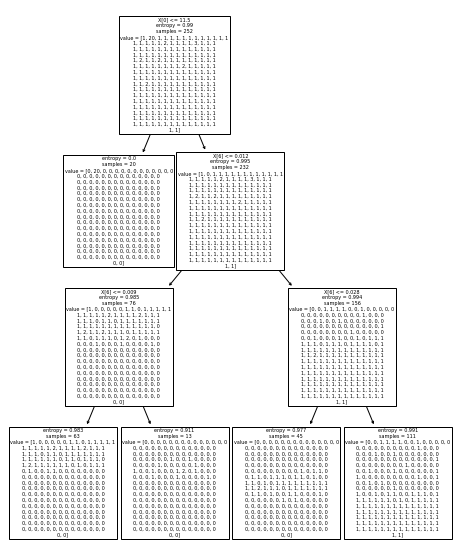

In [127]:

tree.plot_tree(clf);

In [128]:
acc_decision_tree = round(clf.score(X_train, y_train) * 100, 2)
acc_decision_tree

10.71

# Random Forest


It's a supervised learning technics that operate by creating multiple decision trees and outputing the class that is the mode of the class or mean prediction of the individual trees

It will build multiple decision tree and merge them together to get a more accurate prediction.


In [129]:
X = study_cases[study_cases.columns.difference(['new_deaths'])].fillna(study_cases.median())
y = study_cases['new_deaths'].fillna(study_cases.median())
X=X.select_dtypes(['number']).fillna(X.median())
y=y.fillna(y.median())

In [130]:
from sklearn.ensemble import RandomForestRegressor

regressor = RandomForestRegressor(n_estimators=20, random_state=0)
regressor.fit(X_train, y_train)
y_pred = regressor.predict(X_test)

In [131]:
from sklearn import metrics

print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 466.7119047619047
Mean Squared Error: 1391451.0485317458
Root Mean Squared Error: 1179.597833387187


# Study of fatalities

In [132]:
X = study_cases[study_cases.columns.difference(['new_deaths'])].fillna(study_cases.median())
y = study_cases['new_deaths'].fillna(study_cases.median())
X=X.select_dtypes(['number']).fillna(X.median())
y=y.fillna(y.median())

In [133]:
Xfrance = france[france.columns.difference(['new_deaths'])].fillna(france.median())
yfrance = france['new_deaths'].fillna(france.median())
Xfrance=Xfrance.select_dtypes(['number']).fillna(Xfrance.median())
yfrance=yfrance.fillna(yfrance.median())

In [134]:
XItaly = Italy[Italy.columns.difference(['new_deaths'])].fillna(Italy.median())
yItaly = Italy['new_deaths'].fillna(Italy.median())
XItaly=XItaly.select_dtypes(['number']).fillna(XItaly.median())
yItaly=yItaly.fillna(yItaly.median())

In [135]:
XUS = US[US.columns.difference(['new_deaths'])].fillna(US.median())
yUS = US['new_deaths'].fillna(US.median())
XUS=XUS.select_dtypes(['number']).fillna(XUS.median())
yUS=yUS.fillna(yUS.median())

In [136]:
XChina = China[China.columns.difference(['new_deaths'])].fillna(China.median())
yChina = China['new_deaths'].fillna(China.median())
XChina=XChina.select_dtypes(['number']).fillna(XChina.median())
yChina=yChina.fillna(yChina.median())

In [137]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Linear regression

In [138]:
from sklearn.linear_model import LinearRegression
regressor = LinearRegression()
regressor.fit(X_train, y_train)
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
display(coeff_df)
y_pred = regressor.predict(X_test)
df = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred})
display(df)
from sklearn import metrics
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

,Coefficient
Confirmed,-9.236502e-05
Day_num,3.413537e-03
Recovered,8.453930e-05
UID,4.899731e-06
new_cases,1.363217e-02
population,2.373156e-07
positive_rate,2.276703e+02


,Actual,Predicted
18473,0.0,-6.692984
32902,0.0,-6.202245
18235,0.0,-8.137248
10423,0.0,2.659754
57269,0.0,7.748701
...,...,...
51255,0.0,-0.688372
29485,0.0,0.717868
10211,0.0,0.162581
53580,0.0,8.241896


Mean Absolute Error: 29.57273364775376
Mean Squared Error: 23955.0574970899
Root Mean Squared Error: 154.77421457429497


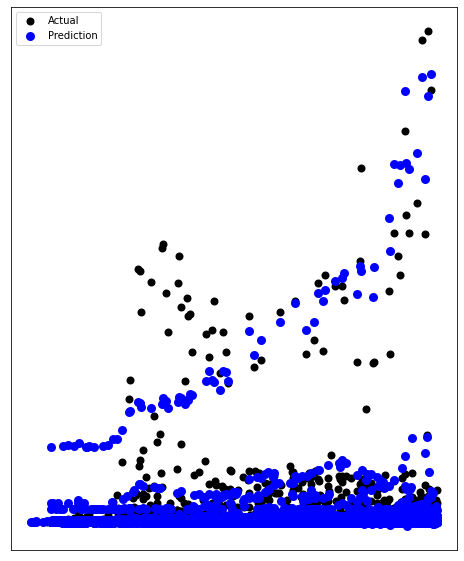

In [139]:
plt.scatter(X_test['Day_num'], y_test,  color='black', label="Actual", linewidth=2)
plt.scatter(X_test['Day_num'], y_pred, color='blue', linewidth=3, label="Prediction")
plt.legend()

plt.xticks(())
plt.yticks(())

plt.show()

In [140]:
X_train, X_test, y_train, y_test = train_test_split(XItaly, yItaly, test_size=0.2, random_state=0)
regressor.fit(X_train, y_train)
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
display(coeff_df)
y_pred = regressor.predict(X_test)
df = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred})
display(df)
from sklearn import metrics
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

,Coefficient
Confirmed,2.248839e-03
Day_num,1.171436e+00
Recovered,-4.058980e-03
UID,-1.573186e-13
new_cases,-2.400034e-02
population,0.000000e+00
positive_rate,1.631803e+03


,Actual,Predicted
25966,889.0,430.626819
26215,684.0,294.814002
26051,24.0,-12.070358
26059,6.0,-19.942781
26009,165.0,222.684434
...,...,...
26182,199.0,117.999670
26076,20.0,-23.719039
25906,0.0,80.046474
25934,3.0,111.334726


Mean Absolute Error: 81.71565961707762
Mean Squared Error: 14264.48387830929
Root Mean Squared Error: 119.43401474583901


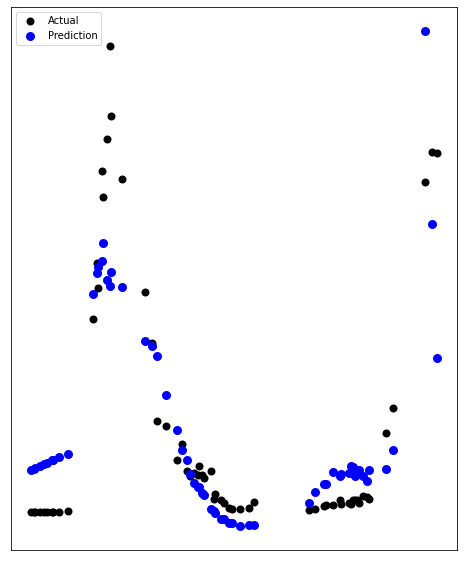

In [141]:
plt.scatter(X_test['Day_num'], y_test,  color='black', label="Actual", linewidth=2)
plt.scatter(X_test['Day_num'], y_pred, color='blue', linewidth=3, label="Prediction")
plt.legend()

plt.xticks(())
plt.yticks(())

plt.show()

In [142]:
X_train, X_test, y_train, y_test = train_test_split(Xfrance, yfrance, test_size=0.2, random_state=0)
regressor.fit(X_train, y_train)
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
display(coeff_df)
y_pred = regressor.predict(X_test)
df = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred})
display(df)
from sklearn import metrics
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

,Coefficient
Confirmed,3.332238e-04
Day_num,-1.265627e+00
Recovered,-9.034870e-04
UID,1.021405e-13
new_cases,2.783271e-03
population,0.000000e+00
positive_rate,3.613179e+01


,Actual,Predicted
18651,320.0,214.069430
18900,1.0,489.874639
18736,7.0,84.530244
18744,35.0,79.061115
18694,70.0,148.021404
...,...,...
18867,547.0,412.768607
18761,18.0,53.749406
18591,0.0,269.395537
18619,0.0,233.954145


Mean Absolute Error: 123.35437239021951
Mean Squared Error: 29165.52981253415
Root Mean Squared Error: 170.77918436546696


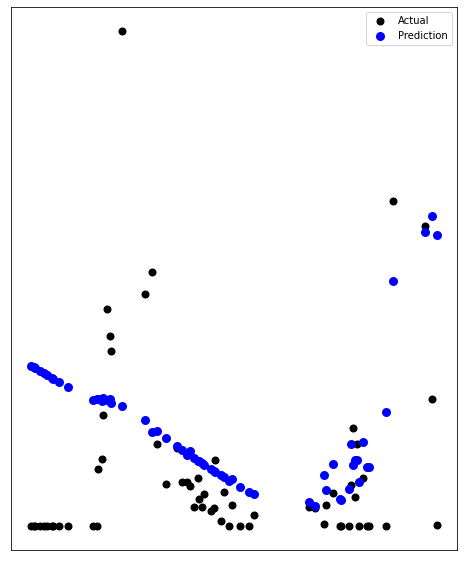

In [143]:
plt.scatter(X_test['Day_num'], y_test,  color='black', label="Actual", linewidth=2)
plt.scatter(X_test['Day_num'], y_pred, color='blue', linewidth=3, label="Prediction")
plt.legend()

plt.xticks(())
plt.yticks(())

plt.show()

In [144]:
X_train, X_test, y_train, y_test = train_test_split(XUS, yUS, test_size=0.2, random_state=0)
regressor.fit(X_train, y_train)
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
display(coeff_df)
y_pred = regressor.predict(X_test)
df = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred})
display(df)
from sklearn import metrics
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

,Coefficient
Confirmed,8.418196e-04
Day_num,-3.612681e-01
Recovered,-1.969848e-03
UID,1.499911e-12
new_cases,-6.391129e-04
population,0.000000e+00
positive_rate,1.045937e+04


,Actual,Predicted
56641,1005.0,683.819602
56794,1090.0,970.261004
56562,35.0,191.647441
56761,928.0,528.643959
56783,936.0,665.101873
...,...,...
56573,633.0,1142.024565
56610,1318.0,1297.333093
56716,1331.0,1072.383597
56721,455.0,980.892410


Mean Absolute Error: 292.44841608025877
Mean Squared Error: 133168.4276440844
Root Mean Squared Error: 364.92249539331556


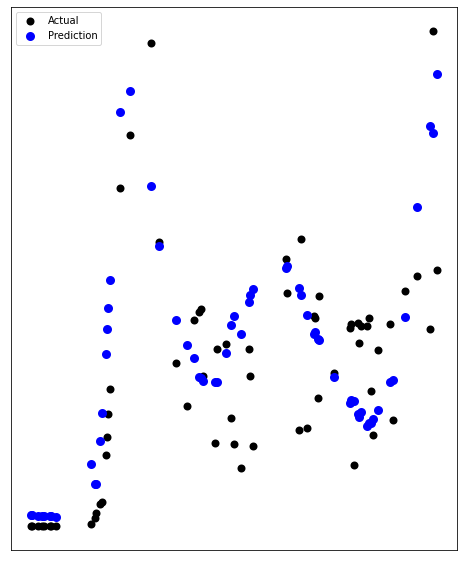

In [145]:
plt.scatter(X_test['Day_num'], y_test,  color='black', label="Actual", linewidth=2)
plt.scatter(X_test['Day_num'], y_pred, color='blue', linewidth=3, label="Prediction")
plt.legend()

plt.xticks(())
plt.yticks(())

plt.show()

In [146]:
X_train, X_test, y_train, y_test = train_test_split(XChina, yChina, test_size=0.2, random_state=0)
regressor.fit(X_train, y_train)
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
display(coeff_df)
y_pred = regressor.predict(X_test)
df = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred})
display(df)
from sklearn import metrics
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

,Coefficient
Confirmed,1.260552e-03
Day_num,-1.183247e-01
Recovered,-8.815907e-04
UID,5.599048e-30
new_cases,2.175937e-02
population,0.000000e+00
positive_rate,5.674722e-34


,Actual,Predicted
11159,0.0,9.888011
11312,1.0,-4.548288
11080,13.0,24.976044
11279,0.0,-1.455667
11301,0.0,-3.730955
...,...,...
11091,3.0,20.980338
11128,0.0,13.651060
11234,2.0,5.117278
11239,0.0,4.006591


Mean Absolute Error: 10.16867041238809
Mean Squared Error: 396.4502170196963
Root Mean Squared Error: 19.911057656982873


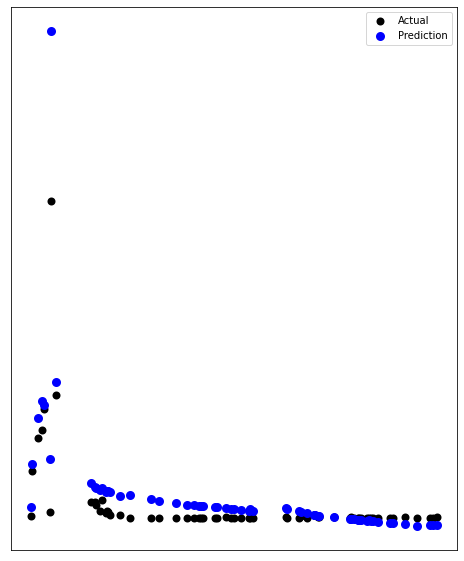

In [147]:
plt.scatter(X_test['Day_num'], y_test,  color='black', label="Actual", linewidth=2)
plt.scatter(X_test['Day_num'], y_pred, color='blue', linewidth=3, label="Prediction")
plt.legend()

plt.xticks(())
plt.yticks(())

plt.show()

# Decision Tree

# Decision tree of the world

In [148]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

In [149]:
from sklearn.tree import DecisionTreeClassifier
classifier = DecisionTreeClassifier()
classifier.fit(X_train, y_train)

DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=None,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=None, splitter='best')

In [150]:
y_pred = classifier.predict(X_test)


In [151]:
from sklearn.metrics import classification_report, confusion_matrix
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 1]
 [0 0 0 ... 0 0 0]]
              precision    recall  f1-score   support

     -1918.0       0.00      0.00      0.00         0
       -18.0       0.00      0.00      0.00         0
       -16.0       0.00      0.00      0.00         0
       -12.0       0.00      0.00      0.00         0
        -6.0       0.00      0.00      0.00         1
        -3.0       0.00      0.00      0.00         0
        -2.0       0.00      0.00      0.00         2
        -1.0       0.00      0.00      0.00         8
         0.0       0.90      0.89      0.90      7206
         1.0       0.21      0.21      0.21       854
         2.0       0.17      0.18      0.17       500
         3.0       0.17      0.16      0.17       326
         4.0       0.16      0.19      0.17       247
         5.0       0.11      0.11      0.11       228
         6.0       0.08      0.11      0.09       148
         7.0   

In [152]:
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
coeff_df

,Coefficient
Confirmed,1.260552e-03
Day_num,-1.183247e-01
Recovered,-8.815907e-04
UID,5.599048e-30
new_cases,2.175937e-02
population,0.000000e+00
positive_rate,5.674722e-34


In [153]:
df=pd.DataFrame({'Actual':y_test, 'Predicted':y_pred})
df

,Actual,Predicted
18473,0.0,0.0
32902,0.0,0.0
18235,0.0,0.0
10423,0.0,0.0
57269,0.0,0.0
...,...,...
51255,0.0,0.0
29485,0.0,0.0
10211,0.0,0.0
53580,0.0,0.0


In [154]:
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 12.131779731298723
Mean Squared Error: 8951.415740587163
Root Mean Squared Error: 94.61192176775167


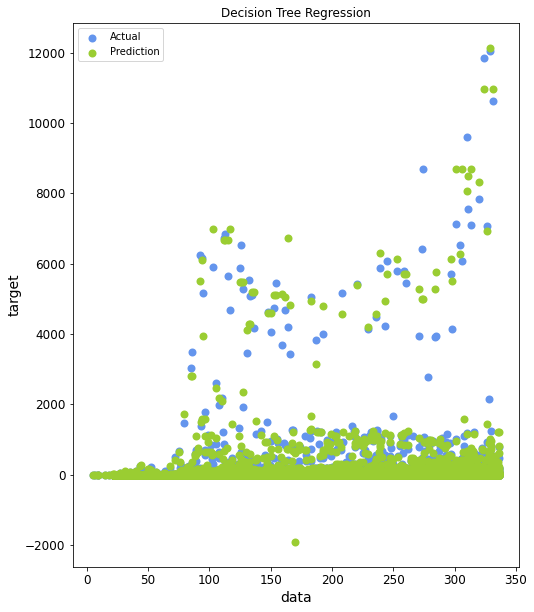

In [155]:
plt.figure()
plt.scatter(X_test['Day_num'], y_test, color="cornflowerblue",
         label="Actual", linewidth=2)
plt.scatter(X_test['Day_num'], y_pred, color="yellowgreen", label="Prediction", linewidth=2)
plt.xlabel("data")
plt.ylabel("target")
plt.title("Decision Tree Regression")
plt.legend()
plt.show()

In [156]:

clf = DecisionTreeClassifier(max_depth = 3, 
                             random_state = 0)
clf.fit(X_train, y_train)


DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=3,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=0, splitter='best')

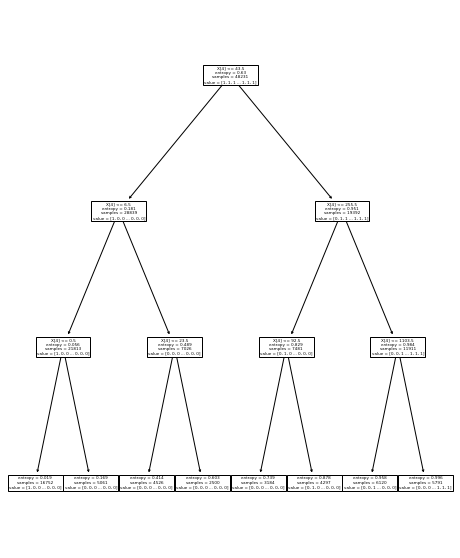

In [157]:
tree.plot_tree(clf);


In [158]:
acc_decision_tree = round(clf.score(X_train, y_train) * 100, 2)
acc_decision_tree

60.16

# Study of specific countries

# France

In [159]:
X_train, X_test, y_train, y_test = train_test_split(Xfrance, yfrance, test_size=0.2, random_state=0)


In [160]:
classifier = DecisionTreeClassifier()
classifier.fit(X_train, y_train)
y_pred = classifier.predict(X_test)
from sklearn.metrics import classification_report, confusion_matrix
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

[[19  1  0 ...  0  0  0]
 [ 0  0  0 ...  0  0  0]
 [ 0  0  0 ...  0  0  0]
 ...
 [ 0  0  0 ...  0  0  0]
 [ 0  0  0 ...  0  0  0]
 [ 0  0  0 ...  0  0  0]]
              precision    recall  f1-score   support

         0.0       0.90      0.86      0.88        22
         1.0       0.00      0.00      0.00         1
         2.0       0.00      0.00      0.00         1
         3.0       0.00      0.00      0.00         0
         7.0       0.00      0.00      0.00         1
         8.0       0.00      0.00      0.00         0
         9.0       0.00      0.00      0.00         0
        10.0       0.00      0.00      0.00         0
        13.0       0.00      0.00      0.00         0
        14.0       0.00      0.00      0.00         0
        18.0       0.00      0.00      0.00         1
        21.0       0.00      0.00      0.00         0
        23.0       0.00      0.00      0.00         0
        24.0       0.00      0.00      0.00         1
        26.0       0.00      0.00

In [161]:
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
coeff_df

,Coefficient
Confirmed,1.260552e-03
Day_num,-1.183247e-01
Recovered,-8.815907e-04
UID,5.599048e-30
new_cases,2.175937e-02
population,0.000000e+00
positive_rate,5.674722e-34


In [162]:
df=pd.DataFrame({'Actual':y_test, 'Predicted':y_pred})
df

,Actual,Predicted
18651,320.0,299.0
18900,1.0,3.0
18736,7.0,23.0
18744,35.0,26.0
18694,70.0,2.0
...,...,...
18867,547.0,221.0
18761,18.0,13.0
18591,0.0,0.0
18619,0.0,1.0


In [163]:
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 57.77777777777778
Mean Squared Error: 17867.11111111111
Root Mean Squared Error: 133.6679135436441


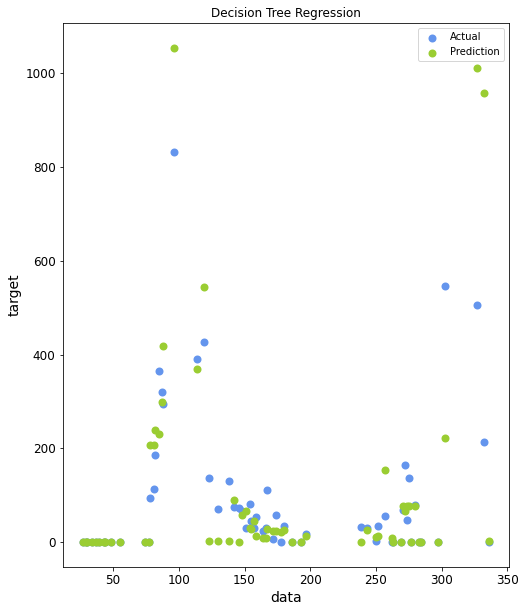

In [164]:
plt.figure()
plt.scatter(X_test['Day_num'], y_test, color="cornflowerblue",
         label="Actual", linewidth=2)
plt.scatter(X_test['Day_num'], y_pred, color="yellowgreen", label="Prediction", linewidth=2)
plt.xlabel("data")
plt.ylabel("target")
plt.title("Decision Tree Regression")
plt.legend()
plt.show()

In [165]:

clf = DecisionTreeClassifier(max_depth = 3, 
                             random_state = 0)
clf.fit(X_train, y_train)


DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=3,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=0, splitter='best')

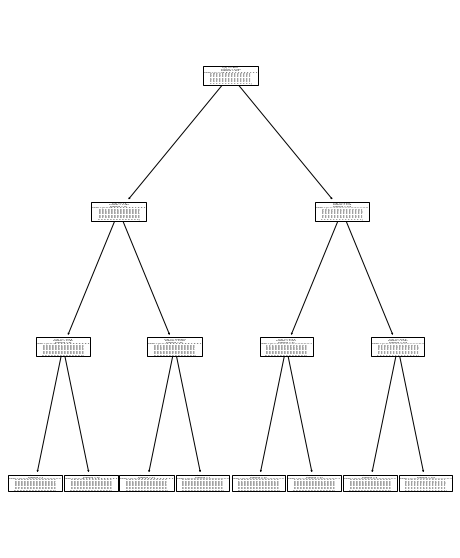

In [166]:
tree.plot_tree(clf);


In [167]:
acc_decision_tree = round(clf.score(X_train, y_train) * 100, 2)
acc_decision_tree

29.37

# China

In [168]:
X_train, X_test, y_train, y_test = train_test_split(XChina, yChina, test_size=0.2, random_state=0)


In [169]:
classifier = DecisionTreeClassifier()
classifier.fit(X_train, y_train)
y_pred = classifier.predict(X_test)
from sklearn.metrics import classification_report, confusion_matrix
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

[[29  1  2  2  1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 3  3  0  2  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  1  0  0  0  0  0  0  0  0  0  0  0  0  1  0  0  0  0  0  0  0]
 [ 0  0  1  1  1  1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  1  0]
 [ 1  0  0  0  0  1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  1  0  0  1  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0

In [170]:
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
coeff_df

,Coefficient
Confirmed,1.260552e-03
Day_num,-1.183247e-01
Recovered,-8.815907e-04
UID,5.599048e-30
new_cases,2.175937e-02
population,0.000000e+00
positive_rate,5.674722e-34


In [171]:
df=pd.DataFrame({'Actual':y_test, 'Predicted':y_pred})
df

,Actual,Predicted
11159,0.0,0.0
11312,1.0,1.0
11080,13.0,14.0
11279,0.0,0.0
11301,0.0,0.0
...,...,...
11091,3.0,5.0
11128,0.0,0.0
11234,2.0,3.0
11239,0.0,2.0


In [172]:
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 6.734375
Mean Squared Error: 599.734375
Root Mean Squared Error: 24.489474779994772


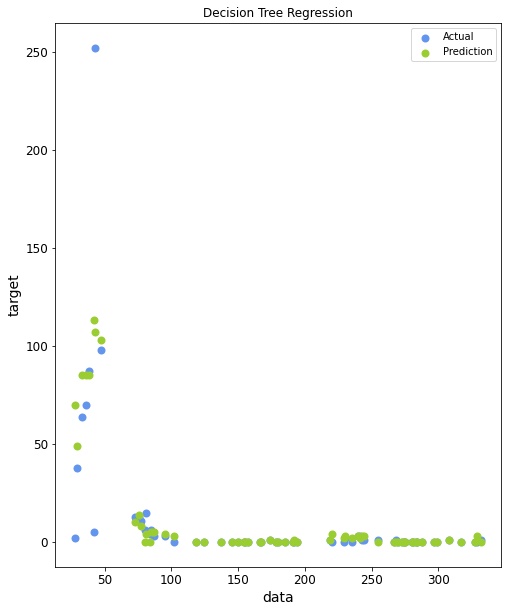

In [173]:
plt.figure()
plt.scatter(X_test['Day_num'], y_test, color="cornflowerblue", label="Actual", linewidth=2)
plt.scatter(X_test['Day_num'], y_pred, color="yellowgreen", label="Prediction", linewidth=2)
plt.xlabel("data")
plt.ylabel("target")
plt.title("Decision Tree Regression")
plt.legend()
plt.show()

In [174]:
clf = DecisionTreeClassifier(max_depth = 3,random_state = 0)
clf.fit(X_train, y_train)

DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=3,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=0, splitter='best')

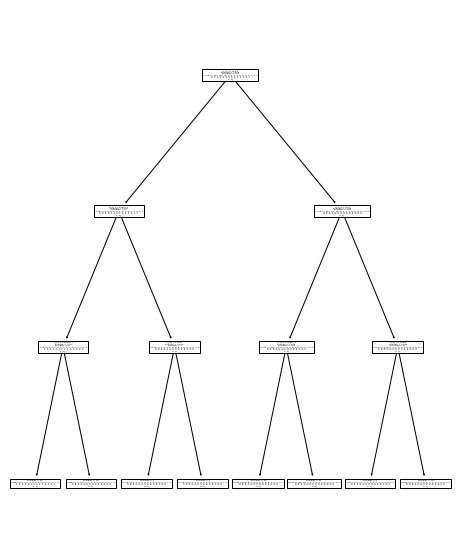

In [175]:
tree.plot_tree(clf);

In [176]:
acc_decision_tree = round(clf.score(X_train, y_train) * 100, 2)
acc_decision_tree

61.51

# US

In [177]:
X_train, X_test, y_train, y_test = train_test_split(XUS, yUS, test_size=0.2, random_state=0)


In [178]:
classifier = DecisionTreeClassifier()
classifier.fit(X_train, y_train)
y_pred = classifier.predict(X_test)
from sklearn.metrics import classification_report, confusion_matrix
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

[[8 0 0 ... 0 0 0]
 [0 0 1 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 1]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00         8
         7.0       0.00      0.00      0.00         1
         8.0       0.00      0.00      0.00         0
        27.0       0.00      0.00      0.00         0
        35.0       0.00      0.00      0.00         1
        59.0       0.00      0.00      0.00         1
        99.0       0.00      0.00      0.00         1
       101.0       0.00      0.00      0.00         0
       110.0       0.00      0.00      0.00         1
       188.0       0.00      0.00      0.00         0
       241.0       0.00      0.00      0.00         0
       269.0       0.00      0.00      0.00         1
       278.0       0.00      0.00      0.00         0
       282.0       0.00      0.00      0.00         1
       312.0       0.00      0.00      0.00         0
       313.0   

In [179]:
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
coeff_df

,Coefficient
Confirmed,1.260552e-03
Day_num,-1.183247e-01
Recovered,-8.815907e-04
UID,5.599048e-30
new_cases,2.175937e-02
population,0.000000e+00
positive_rate,5.674722e-34


In [180]:
df=pd.DataFrame({'Actual':y_test, 'Predicted':y_pred})
df

,Actual,Predicted
56641,1005.0,906.0
56794,1090.0,473.0
56562,35.0,27.0
56761,928.0,702.0
56783,936.0,951.0
...,...,...
56573,633.0,592.0
56610,1318.0,1465.0
56716,1331.0,720.0
56721,455.0,984.0


In [181]:
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 224.421875
Mean Squared Error: 105871.578125
Root Mean Squared Error: 325.379129823964


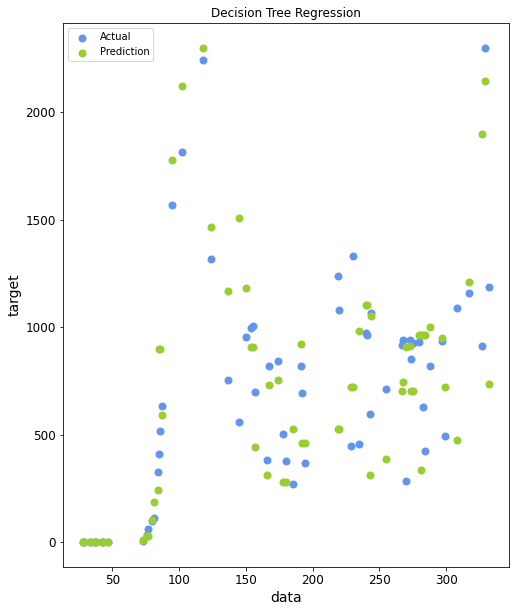

In [182]:
plt.figure()
plt.scatter(X_test['Day_num'], y_test, color="cornflowerblue", label="Actual", linewidth=2)
plt.scatter(X_test['Day_num'], y_pred, color="yellowgreen", label="Prediction", linewidth=2)
plt.xlabel("data")
plt.ylabel("target")
plt.title("Decision Tree Regression")
plt.legend()
plt.show()

In [183]:
clf = DecisionTreeClassifier(max_depth = 3,random_state = 0)
clf.fit(X_train, y_train)

DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=3,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=0, splitter='best')

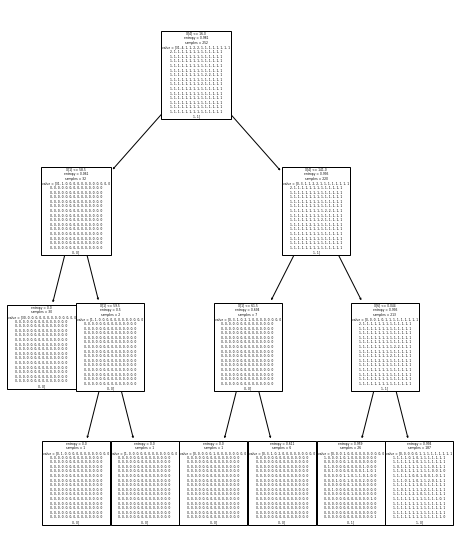

In [184]:
tree.plot_tree(clf);

In [185]:
acc_decision_tree = round(clf.score(X_train, y_train) * 100, 2)
acc_decision_tree

15.87

# italy

In [186]:
X_train, X_test, y_train, y_test = train_test_split(XItaly, yItaly, test_size=0.2, random_state=0)


In [187]:
classifier = DecisionTreeClassifier()
classifier.fit(X_train, y_train)
y_pred = classifier.predict(X_test)
from sklearn.metrics import classification_report, confusion_matrix
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

[[9 0 0 ... 0 0 0]
 [0 0 1 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 1]
 [0 0 0 ... 0 0 0]]
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00         9
         3.0       0.00      0.00      0.00         1
         4.0       0.00      0.00      0.00         0
         5.0       0.00      0.00      0.00         1
         6.0       0.00      0.00      0.00         2
         7.0       0.00      0.00      0.00         1
         8.0       0.00      0.00      0.00         1
         9.0       0.00      0.00      0.00         1
        10.0       0.00      0.00      0.00         0
        11.0       0.00      0.00      0.00         0
        12.0       0.00      0.00      0.00         1
        13.0       0.00      0.00      0.00         0
        14.0       0.00      0.00      0.00         2
        15.0       0.00      0.00      0.00         1
        16.0       0.00      0.00      0.00         1
        17.0   

In [188]:
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
coeff_df

,Coefficient
Confirmed,1.260552e-03
Day_num,-1.183247e-01
Recovered,-8.815907e-04
UID,5.599048e-30
new_cases,2.175937e-02
population,0.000000e+00
positive_rate,5.674722e-34


In [189]:
df=pd.DataFrame({'Actual':y_test, 'Predicted':y_pred})
df

,Actual,Predicted
25966,889.0,919.0
26215,684.0,43.0
26051,24.0,23.0
26059,6.0,22.0
26009,165.0,179.0
...,...,...
26182,199.0,217.0
26076,20.0,11.0
25906,0.0,0.0
25934,3.0,4.0


In [190]:
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 50.42857142857143
Mean Squared Error: 13646.20634920635
Root Mean Squared Error: 116.81697800065858


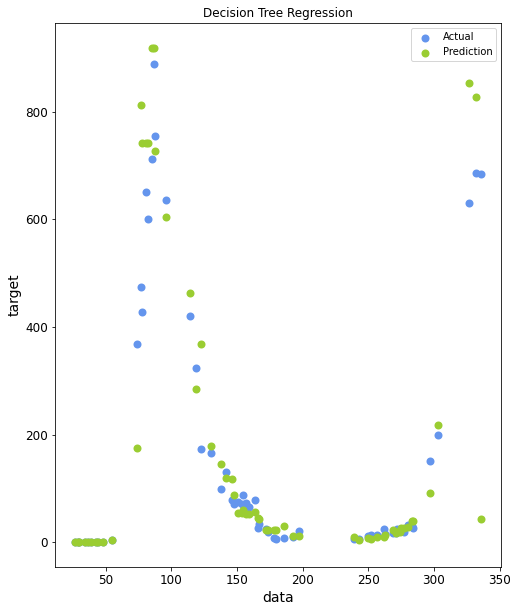

In [191]:
plt.figure()
plt.scatter(X_test['Day_num'], y_test, color="cornflowerblue", label="Actual", linewidth=2)
plt.scatter(X_test['Day_num'], y_pred, color="yellowgreen", label="Prediction", linewidth=2)
plt.xlabel("data")
plt.ylabel("target")
plt.title("Decision Tree Regression")
plt.legend()
plt.show()

In [192]:
clf = DecisionTreeClassifier(max_depth = 3,random_state = 0)
clf.fit(X_train, y_train)

DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=3,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=0, splitter='best')

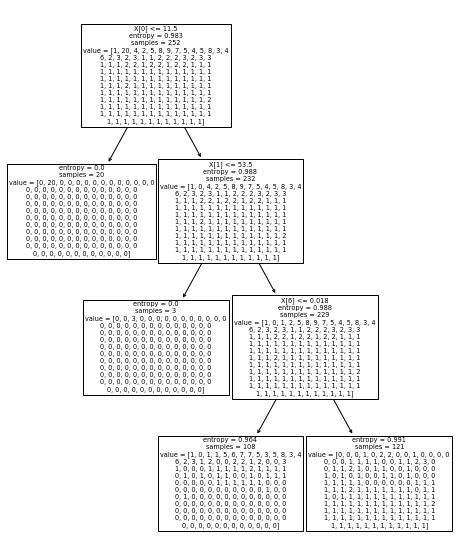

In [193]:
tree.plot_tree(clf);

In [194]:
acc_decision_tree = round(clf.score(X_train, y_train) * 100, 2)
acc_decision_tree

13.49

# Study of Recoveries

In [195]:
X = study_cases[study_cases.columns.difference(['Recovered'])].fillna(study_cases.median())
y = study_cases['Recovered'].fillna(study_cases.median())
X=X.select_dtypes(['number']).fillna(X.median())
y=y.fillna(y.median())

In [196]:
Xfrance = france[france.columns.difference(['Recovered'])].fillna(france.median())
yfrance = france['Recovered'].fillna(france.median())
Xfrance=Xfrance.select_dtypes(['number']).fillna(Xfrance.median())
yfrance=yfrance.fillna(yfrance.median())

In [197]:
XItaly = Italy[Italy.columns.difference(['Recovered'])].fillna(Italy.median())
yItaly = Italy['Recovered'].fillna(Italy.median())
XItaly=XItaly.select_dtypes(['number']).fillna(XItaly.median())
yItaly=yItaly.fillna(yItaly.median())

In [198]:
XUS = US[US.columns.difference(['Recovered'])].fillna(US.median())
yUS = US['Recovered'].fillna(US.median())
XUS=XUS.select_dtypes(['number']).fillna(XUS.median())
yUS=yUS.fillna(yUS.median())

In [199]:
XChina = China[China.columns.difference(['Recovered'])].fillna(China.median())
yChina = China['Recovered'].fillna(China.median())
XChina=XChina.select_dtypes(['number']).fillna(XChina.median())
yChina=yChina.fillna(yChina.median())

In [200]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Linear regression

In [201]:
from sklearn.linear_model import LinearRegression
regressor = LinearRegression()
regressor.fit(X_train, y_train)
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
display(coeff_df)
y_pred = regressor.predict(X_test)
df = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred})
display(df)
from sklearn import metrics
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

,Coefficient
Confirmed,0.708751
Day_num,-10.578479
UID,-0.016139
new_cases,-2.011540
new_deaths,53.806070
population,0.000028
positive_rate,-74881.623816


,Actual,Predicted
18473,7050.0,7975.381178
32902,13.0,3113.159098
18235,31.0,1824.394724
10423,0.0,2276.918949
57269,2908.0,4207.033984
...,...,...
51255,858.0,2082.712737
29485,251.0,1715.417271
10211,23.0,1616.522829
53580,3277.0,6687.470377


Mean Absolute Error: 21197.806334664874
Mean Squared Error: 13094770189.759153
Root Mean Squared Error: 114432.38260981528


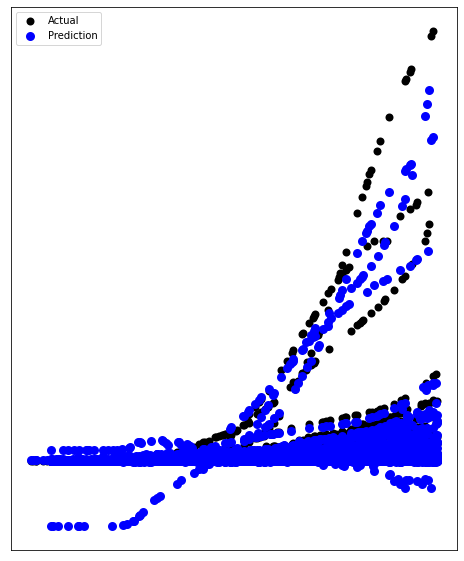

In [202]:
plt.scatter(X_test['Day_num'], y_test,  color='black', label="Actual", linewidth=2)
plt.scatter(X_test['Day_num'], y_pred, color='blue', linewidth=3, label="Prediction")
plt.legend()

plt.xticks(())
plt.yticks(())

plt.show()

In [203]:
X_train, X_test, y_train, y_test = train_test_split(XItaly, yItaly, test_size=0.2, random_state=0)
regressor.fit(X_train, y_train)
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
display(coeff_df)
y_pred = regressor.predict(X_test)
df = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred})
display(df)
from sklearn import metrics
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

,Coefficient
Confirmed,4.549633e-01
Day_num,4.947811e+02
UID,-3.524292e-12
new_cases,-5.325628e+00
new_deaths,-6.914749e+01
population,0.000000e+00
positive_rate,5.252209e+04


,Actual,Predicted
25966,12384.0,-21437.487751
26215,823335.0,733704.884563
26051,182893.0,167301.477041
26059,189196.0,173960.078016
26009,105186.0,125693.534702
...,...,...
26182,283567.0,248472.119168
26076,196246.0,182350.805145
25906,0.0,-8469.397795
25934,1.0,4828.245028


Mean Absolute Error: 15114.584139919605
Mean Squared Error: 416355192.97398674
Root Mean Squared Error: 20404.783580670166


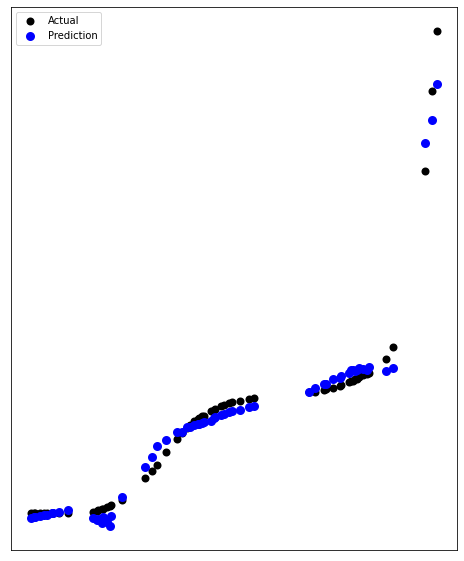

In [204]:
plt.scatter(X_test['Day_num'], y_test,  color='black', label="Actual", linewidth=2)
plt.scatter(X_test['Day_num'], y_pred, color='blue', linewidth=3, label="Prediction")
plt.legend()

plt.xticks(())
plt.yticks(())

plt.show()

In [205]:
X_train, X_test, y_train, y_test = train_test_split(Xfrance, yfrance, test_size=0.2, random_state=0)
regressor.fit(X_train, y_train)
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
display(coeff_df)
y_pred = regressor.predict(X_test)
df = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred})
display(df)
from sklearn import metrics
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

,Coefficient
Confirmed,2.446228e-02
Day_num,4.283455e+02
UID,9.521273e-12
new_cases,3.418283e-02
new_deaths,-8.259113e-01
population,0.000000e+00
positive_rate,-1.901641e+05


,Actual,Predicted
18651,5724.0,21169.708576
18900,171197.0,183206.258159
18736,74496.0,65202.142707
18744,76124.0,69141.399990
18694,56327.0,43044.934489
...,...,...
18867,122224.0,114137.848281
18761,79161.0,76810.142473
18591,0.0,-5359.495596
18619,11.0,6634.457578


Mean Absolute Error: 8559.815780401199
Mean Squared Error: 93618764.78415343
Root Mean Squared Error: 9675.67903478373


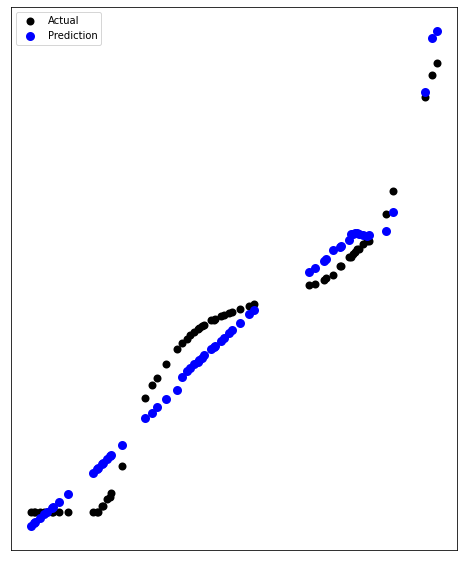

In [206]:
plt.scatter(X_test['Day_num'], y_test,  color='black', label="Actual", linewidth=2)
plt.scatter(X_test['Day_num'], y_pred, color='blue', linewidth=3, label="Prediction")
plt.legend()

plt.xticks(())
plt.yticks(())

plt.show()

In [207]:
X_train, X_test, y_train, y_test = train_test_split(XUS, yUS, test_size=0.2, random_state=0)
regressor.fit(X_train, y_train)
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
display(coeff_df)
y_pred = regressor.predict(X_test)
df = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred})
display(df)
from sklearn import metrics
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

,Coefficient
Confirmed,4.943789e-01
Day_num,-2.677274e+03
UID,-3.168111e-09
new_cases,-3.217751e+00
new_deaths,-8.257132e+01
population,0.000000e+00
positive_rate,1.230807e+06


,Actual,Predicted
56641,485002.0,4.732766e+05
56794,3743527.0,3.618419e+06
56562,17.0,-8.574326e+04
56761,2873369.0,2.747020e+06
56783,3406656.0,3.234836e+06
...,...,...
56573,1072.0,-6.107772e+04
56610,187180.0,2.539260e+05
56716,1898159.0,1.968779e+06
56721,1997761.0,2.159646e+06


Mean Absolute Error: 69540.97808317277
Mean Squared Error: 7878212339.633779
Root Mean Squared Error: 88759.29438449687


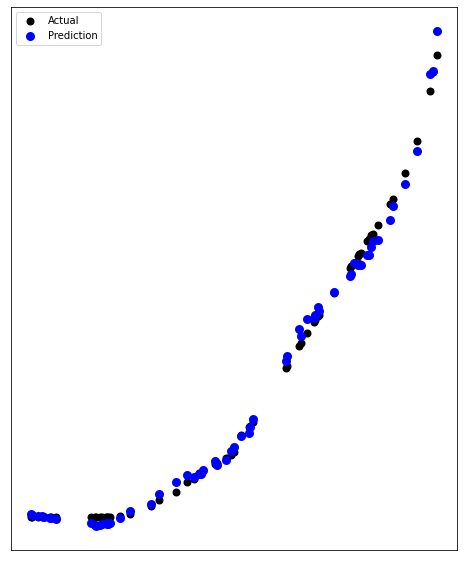

In [208]:
plt.scatter(X_test['Day_num'], y_test,  color='black', label="Actual", linewidth=2)
plt.scatter(X_test['Day_num'], y_pred, color='blue', linewidth=3, label="Prediction")
plt.legend()

plt.xticks(())
plt.yticks(())

plt.show()

In [209]:
X_train, X_test, y_train, y_test = train_test_split(XChina, yChina, test_size=0.2, random_state=0)
regressor.fit(X_train, y_train)
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
display(coeff_df)
y_pred = regressor.predict(X_test)
df = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred})
display(df)
from sklearn import metrics
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

,Coefficient
Confirmed,6.814248e-01
Day_num,7.731555e+01
UID,5.879013e-29
new_cases,-8.876395e+00
new_deaths,-1.131120e+01
population,0.000000e+00
positive_rate,2.078644e-33


,Actual,Predicted
11159,79415.0,73781.320457
11312,86241.0,90422.056487
11080,68798.0,65280.801025
11279,85494.0,87375.905994
11301,85974.0,89420.914091
...,...,...
11091,75100.0,66202.122498
11128,78792.0,71324.733779
11234,83408.0,82811.780385
11239,83988.0,83464.463697


Mean Absolute Error: 6199.966119727558
Mean Squared Error: 187828731.01668775
Root Mean Squared Error: 13705.062240525862


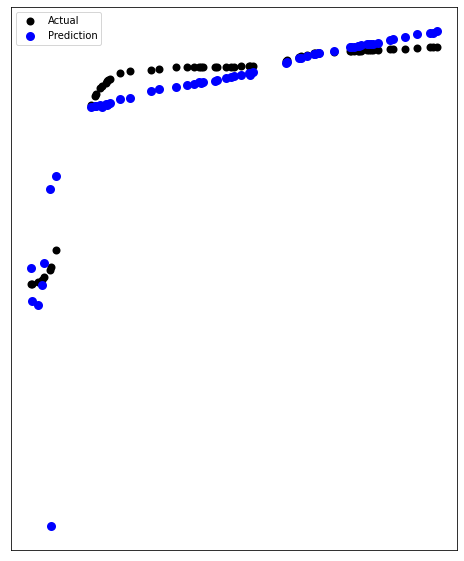

In [210]:
plt.scatter(X_test['Day_num'], y_test,  color='black', label="Actual", linewidth=2)
plt.scatter(X_test['Day_num'], y_pred, color='blue', linewidth=3, label="Prediction")
plt.legend()

plt.xticks(())
plt.yticks(())

plt.show()

# Decision Tree

# Decision tree of the world

In [211]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

In [212]:
from sklearn.tree import DecisionTreeClassifier
classifier = DecisionTreeClassifier()
classifier.fit(X_train, y_train)

DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=None,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=None, splitter='best')

In [213]:
y_pred = classifier.predict(X_test)


In [214]:
from sklearn.metrics import classification_report, confusion_matrix
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

[[2174   14    6 ...    0    0    0]
 [  30  127    6 ...    0    0    0]
 [   2    5   66 ...    0    0    0]
 ...
 [   0    0    0 ...    0    0    1]
 [   0    0    0 ...    0    0    1]
 [   0    0    0 ...    0    0    0]]
              precision    recall  f1-score   support

         0.0       0.98      0.98      0.98      2213
         1.0       0.77      0.71      0.74       178
         2.0       0.73      0.76      0.74        87
         3.0       0.60      0.66      0.63        53
         4.0       0.73      0.56      0.64        48
         5.0       0.64      0.69      0.67        49
         6.0       0.68      0.78      0.72        32
         7.0       0.62      0.81      0.70        32
         8.0       0.84      0.82      0.83        93
         9.0       0.60      0.69      0.64        39
        10.0       0.67      0.71      0.69        28
        11.0       0.79      0.84      0.81        31
        12.0       0.62      0.38      0.48        13
        13.0   

In [215]:
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
coeff_df

,Coefficient
Confirmed,6.814248e-01
Day_num,7.731555e+01
UID,5.879013e-29
new_cases,-8.876395e+00
new_deaths,-1.131120e+01
population,0.000000e+00
positive_rate,2.078644e-33


In [216]:
df=pd.DataFrame({'Actual':y_test, 'Predicted':y_pred})
df

,Actual,Predicted
18473,7050.0,7050.0
32902,13.0,13.0
18235,31.0,31.0
10423,0.0,0.0
57269,2908.0,2859.0
...,...,...
51255,858.0,858.0
29485,251.0,726.0
10211,23.0,146.0
53580,3277.0,3274.0


In [217]:
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 6350.744899651683
Mean Squared Error: 4428618369.896003
Root Mean Squared Error: 66547.86525423639


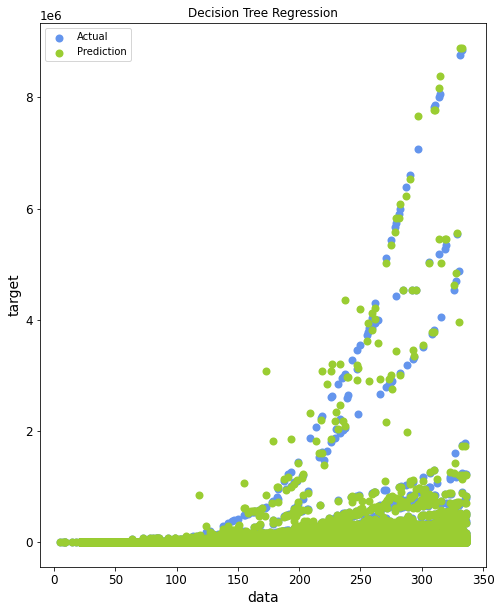

In [218]:
plt.figure()
plt.scatter(X_test['Day_num'], y_test, color="cornflowerblue",
         label="Actual", linewidth=2)
plt.scatter(X_test['Day_num'], y_pred, color="yellowgreen", label="Prediction", linewidth=2)
plt.xlabel("data")
plt.ylabel("target")
plt.title("Decision Tree Regression")
plt.legend()
plt.show()

In [219]:

clf = DecisionTreeClassifier(max_depth = 3,random_state = 0)

clf.fit(X_train, y_train)


DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=3,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=0, splitter='best')

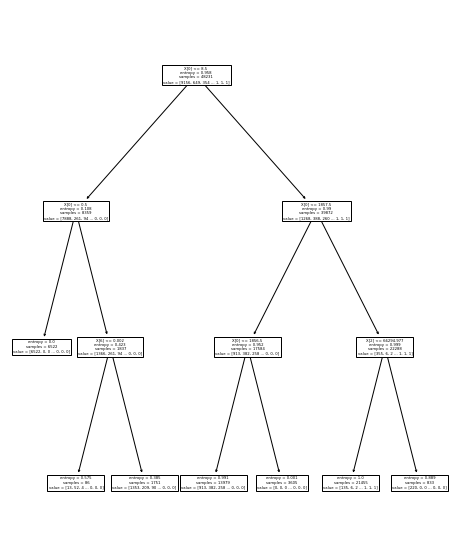

In [220]:
tree.plot_tree(clf);


In [221]:
acc_decision_tree = round(clf.score(X_train, y_train) * 100, 2)
acc_decision_tree

26.54

# Study of specific countries

# France

In [222]:
X_train, X_test, y_train, y_test = train_test_split(Xfrance, yfrance, test_size=0.2, random_state=0)


In [223]:
classifier = DecisionTreeClassifier()
classifier.fit(X_train, y_train)
y_pred = classifier.predict(X_test)
from sklearn.metrics import classification_report, confusion_matrix
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

[[6 0 0 ... 0 0 0]
 [0 2 0 ... 0 0 0]
 [0 0 1 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 1 0]]
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00         6
         2.0       1.00      1.00      1.00         2
         4.0       0.50      1.00      0.67         1
        11.0       0.00      0.00      0.00         1
        12.0       0.75      1.00      0.86         3
      2206.0       0.00      0.00      0.00         2
      3250.0       0.00      0.00      0.00         0
      3907.0       0.00      0.00      0.00         0
      4955.0       0.00      0.00      0.00         1
      5707.0       0.00      0.00      0.00         0
      5724.0       0.00      0.00      0.00         1
      7226.0       0.00      0.00      0.00         1
      7964.0       0.00      0.00      0.00         0
     17428.0       0.00      0.00      0.00         1
     19523.0       0.00      0.00      0.00         0
     40657.0   

In [224]:
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
coeff_df

,Coefficient
Confirmed,6.814248e-01
Day_num,7.731555e+01
UID,5.879013e-29
new_cases,-8.876395e+00
new_deaths,-1.131120e+01
population,0.000000e+00
positive_rate,2.078644e-33


In [225]:
df=pd.DataFrame({'Actual':y_test, 'Predicted':y_pred})
df

,Actual,Predicted
18651,5724.0,5707.0
18900,171197.0,169663.0
18736,74496.0,72982.0
18744,76124.0,71952.0
18694,56327.0,56148.0
...,...,...
18867,122224.0,123095.0
18761,79161.0,80600.0
18591,0.0,0.0
18619,11.0,4.0


In [226]:
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 2382.84126984127
Mean Squared Error: 24016527.031746034
Root Mean Squared Error: 4900.665978389676


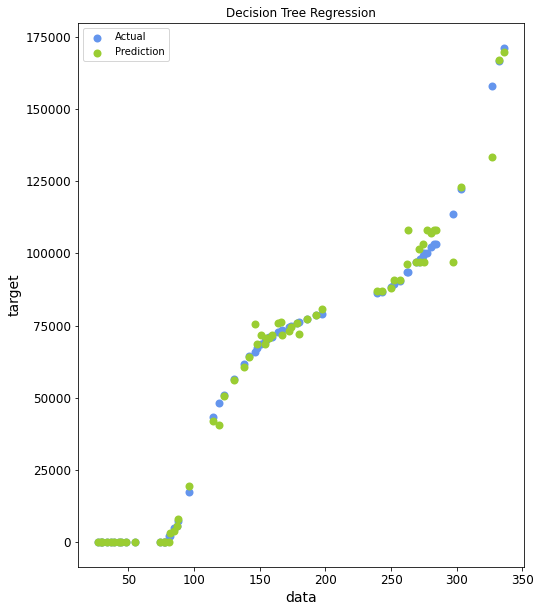

In [227]:
plt.figure()
plt.scatter(X_test['Day_num'], y_test, color="cornflowerblue",
         label="Actual", linewidth=2)
plt.scatter(X_test['Day_num'], y_pred, color="yellowgreen", label="Prediction", linewidth=2)
plt.xlabel("data")
plt.ylabel("target")
plt.title("Decision Tree Regression")
plt.legend()
plt.show()

In [228]:

clf = DecisionTreeClassifier(max_depth = 3,random_state = 0)

clf.fit(X_train, y_train)


DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=3,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=0, splitter='best')

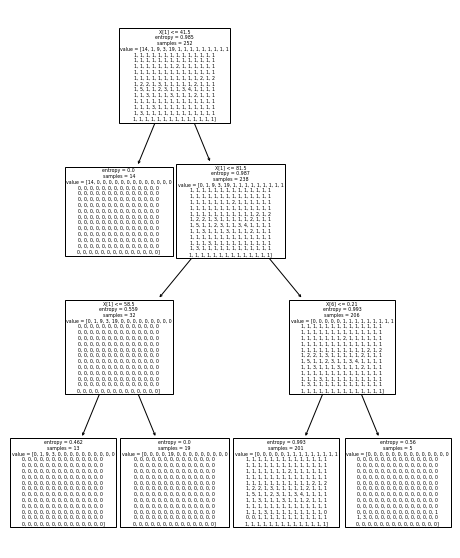

In [229]:
tree.plot_tree(clf);


In [230]:
acc_decision_tree = round(clf.score(X_train, y_train) * 100, 2)
acc_decision_tree

19.84

# China

In [231]:
X_train, X_test, y_train, y_test = train_test_split(XChina, yChina, test_size=0.2, random_state=0)


In [232]:
classifier = DecisionTreeClassifier()
classifier.fit(X_train, y_train)
y_pred = classifier.predict(X_test)
from sklearn.metrics import classification_report, confusion_matrix
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

[[0 0 0 ... 0 0 0]
 [0 0 1 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 1]
 [0 0 0 ... 0 0 0]]
              precision    recall  f1-score   support

       120.0       0.00      0.00      0.00       1.0
       135.0       0.00      0.00      0.00       1.0
       214.0       0.00      0.00      0.00       0.0
       463.0       0.00      0.00      0.00       0.0
       614.0       0.00      0.00      0.00       1.0
      1115.0       0.00      0.00      0.00       0.0
      1477.0       0.00      0.00      0.00       1.0
      1999.0       0.00      0.00      0.00       0.0
      2596.0       0.00      0.00      0.00       1.0
      4636.0       0.00      0.00      0.00       0.0
      5082.0       0.00      0.00      0.00       1.0
      6217.0       0.00      0.00      0.00       1.0
      7977.0       0.00      0.00      0.00       0.0
     10755.0       0.00      0.00      0.00       0.0
     12462.0       0.00      0.00      0.00       1.0
     23187.0   

In [233]:
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
coeff_df

,Coefficient
Confirmed,6.814248e-01
Day_num,7.731555e+01
UID,5.879013e-29
new_cases,-8.876395e+00
new_deaths,-1.131120e+01
population,0.000000e+00
positive_rate,2.078644e-33


In [234]:
df=pd.DataFrame({'Actual':y_test, 'Predicted':y_pred})
df

,Actual,Predicted
11159,79415.0,79456.0
11312,86241.0,84546.0
11080,68798.0,67017.0
11279,85494.0,85819.0
11301,85974.0,85762.0
...,...,...
11091,75100.0,77877.0
11128,78792.0,78870.0
11234,83408.0,82440.0
11239,83988.0,84058.0


In [235]:
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 1420.546875
Mean Squared Error: 19044756.109375
Root Mean Squared Error: 4364.029801613985


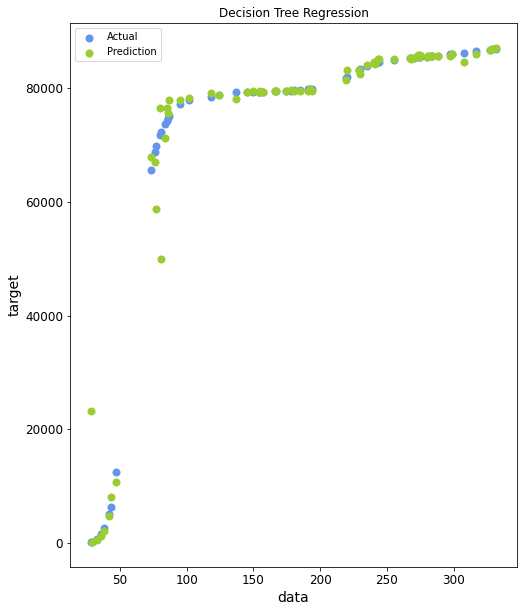

In [236]:
plt.figure()
plt.scatter(X_test['Day_num'], y_test, color="cornflowerblue", label="Actual", linewidth=2)
plt.scatter(X_test['Day_num'], y_pred, color="yellowgreen", label="Prediction", linewidth=2)
plt.xlabel("data")
plt.ylabel("target")
plt.title("Decision Tree Regression")
plt.legend()
plt.show()

In [237]:
clf = DecisionTreeClassifier(max_depth = 3,random_state = 0)
clf.fit(X_train, y_train)

DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=3,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=0, splitter='best')

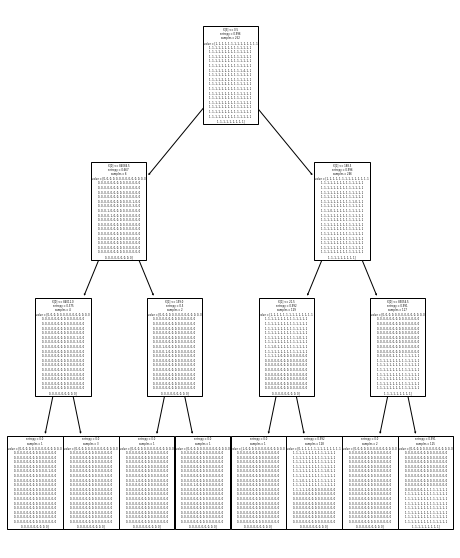

In [238]:
tree.plot_tree(clf);

In [239]:
acc_decision_tree = round(clf.score(X_train, y_train) * 100, 2)
acc_decision_tree

4.37

# US

In [240]:
X_train, X_test, y_train, y_test = train_test_split(XUS, yUS, test_size=0.2, random_state=0)


In [241]:
classifier = DecisionTreeClassifier()
classifier.fit(X_train, y_train)
y_pred = classifier.predict(X_test)
from sklearn.metrics import classification_report, confusion_matrix
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

[[5 0 0 ... 0 0 0]
 [0 3 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 1 0 0]
 [0 0 0 ... 0 0 0]]
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00         5
         3.0       1.00      1.00      1.00         3
         8.0       0.00      0.00      0.00         0
        12.0       0.00      0.00      0.00         1
        17.0       1.00      1.00      1.00         1
       105.0       0.00      0.00      0.00         1
       121.0       0.00      0.00      0.00         0
       147.0       0.00      0.00      0.00         0
       176.0       0.00      0.00      0.00         1
       178.0       1.00      1.00      1.00         1
       361.0       0.00      0.00      0.00         1
       681.0       0.00      0.00      0.00         1
       869.0       0.00      0.00      0.00         1
      1072.0       0.00      0.00      0.00         1
      2665.0       0.00      0.00      0.00         0
     14652.0   

In [242]:
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
coeff_df

,Coefficient
Confirmed,6.814248e-01
Day_num,7.731555e+01
UID,5.879013e-29
new_cases,-8.876395e+00
new_deaths,-1.131120e+01
population,0.000000e+00
positive_rate,2.078644e-33


In [243]:
df=pd.DataFrame({'Actual':y_test, 'Predicted':y_pred})
df

,Actual,Predicted
56641,485002.0,617460.0
56794,3743527.0,3705130.0
56562,17.0,17.0
56761,2873369.0,3039089.0
56783,3406656.0,1818527.0
...,...,...
56573,1072.0,2665.0
56610,187180.0,180152.0
56716,1898159.0,1818527.0
56721,1997761.0,2020774.0


In [244]:
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 304935.21875
Mean Squared Error: 429850981208.65625
Root Mean Squared Error: 655630.2168209273


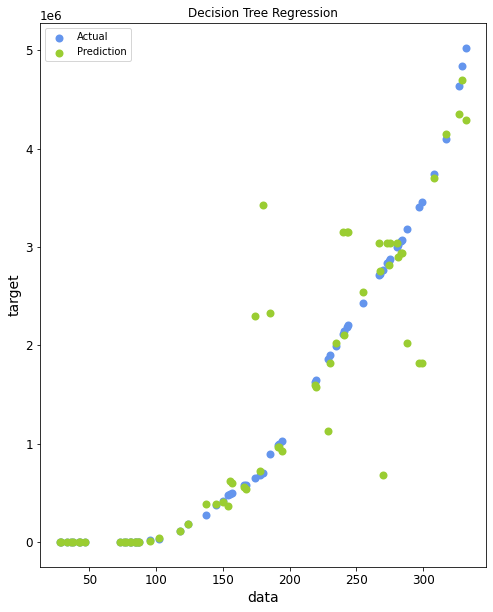

In [245]:
plt.figure()
plt.scatter(X_test['Day_num'], y_test, color="cornflowerblue", label="Actual", linewidth=2)
plt.scatter(X_test['Day_num'], y_pred, color="yellowgreen", label="Prediction", linewidth=2)
plt.xlabel("data")
plt.ylabel("target")
plt.title("Decision Tree Regression")
plt.legend()
plt.show()

In [246]:
clf = DecisionTreeClassifier(max_depth = 3,random_state = 0)
clf.fit(X_train, y_train)

DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=3,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=0, splitter='best')

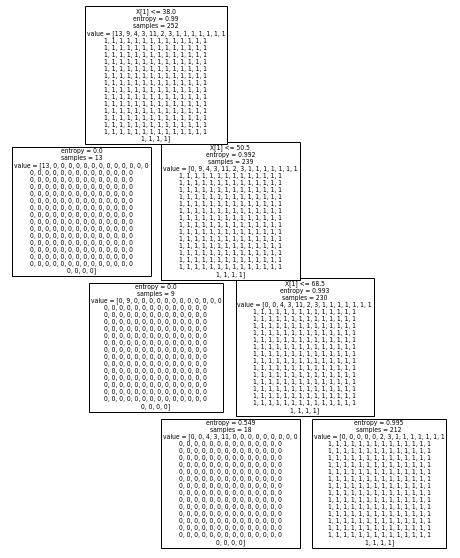

In [247]:
tree.plot_tree(clf);

In [248]:
acc_decision_tree = round(clf.score(X_train, y_train) * 100, 2)
acc_decision_tree

14.29

# italy

In [249]:
X_train, X_test, y_train, y_test = train_test_split(XItaly, yItaly, test_size=0.2, random_state=0)


In [250]:
classifier = DecisionTreeClassifier()
classifier.fit(X_train, y_train)
y_pred = classifier.predict(X_test)
from sklearn.metrics import classification_report, confusion_matrix
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

[[9 0 0 ... 0 0 0]
 [0 0 1 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 1 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00         9
         1.0       0.00      0.00      0.00         1
         3.0       0.00      0.00      0.00         0
      2335.0       0.00      0.00      0.00         1
      2749.0       0.00      0.00      0.00         0
      2941.0       0.00      0.00      0.00         0
      4025.0       0.00      0.00      0.00         1
      4440.0       1.00      1.00      1.00         1
      6072.0       0.00      0.00      0.00         0
      7024.0       0.00      0.00      0.00         2
      8326.0       0.00      0.00      0.00         0
     10361.0       0.00      0.00      0.00         1
     10950.0       0.00      0.00      0.00         0
     12384.0       0.00      0.00      0.00         1
     13030.0       0.00      0.00      0.00         1
     14620.0   

In [251]:
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
coeff_df

,Coefficient
Confirmed,6.814248e-01
Day_num,7.731555e+01
UID,5.879013e-29
new_cases,-8.876395e+00
new_deaths,-1.131120e+01
population,0.000000e+00
positive_rate,2.078644e-33


In [252]:
df=pd.DataFrame({'Actual':y_test, 'Predicted':y_pred})
df

,Actual,Predicted
25966,12384.0,10950.0
26215,823335.0,79914.0
26051,182893.0,183426.0
26059,189196.0,197431.0
26009,105186.0,120205.0
...,...,...
26182,283567.0,275404.0
26076,196246.0,193978.0
25906,0.0,0.0
25934,1.0,3.0


In [253]:
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 16205.36507936508
Mean Squared Error: 8953283918.349207
Root Mean Squared Error: 94621.79409813158


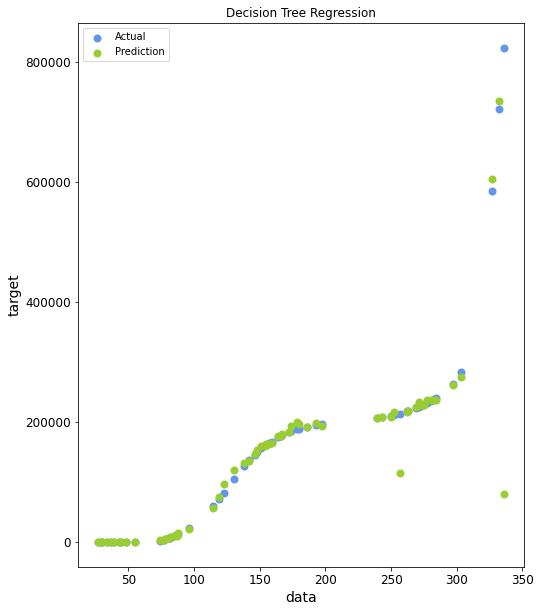

In [254]:
plt.figure()
plt.scatter(X_test['Day_num'], y_test, color="cornflowerblue", label="Actual", linewidth=2)
plt.scatter(X_test['Day_num'], y_pred, color="yellowgreen", label="Prediction", linewidth=2)
plt.xlabel("data")
plt.ylabel("target")
plt.title("Decision Tree Regression")
plt.legend()
plt.show()

In [255]:
clf = DecisionTreeClassifier(max_depth = 3,random_state = 0)
clf.fit(X_train, y_train)

DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=3,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=0, splitter='best')

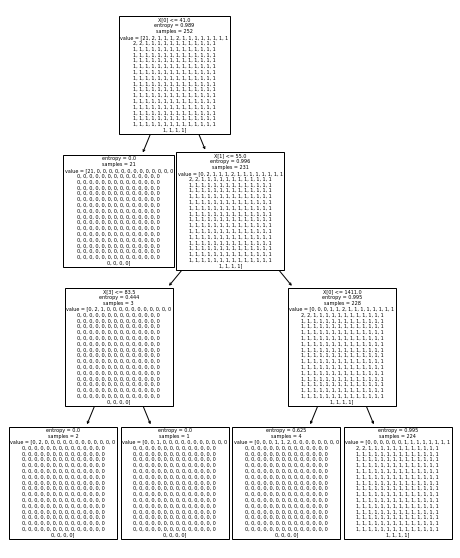

In [256]:
tree.plot_tree(clf);

In [257]:
acc_decision_tree = round(clf.score(X_train, y_train) * 100, 2)
acc_decision_tree

11.11

# CONCLUSION




On our datasets, we used various supervised learning techniques.
Linear Regression, Decision Tree and Random Forest.
Here's the Mean Utter Error that we've got from every technique.

Mean Absolute Error (MAE): MAE calculates the average magnitude of errors in a series of predictions without taking into account their course.

Case of the world:
Linear Regression: 1553.86 degrees
Decision tree: 402.51 degrees
Random forest: 257.04 degrees


Using various techniques, we were able to see if, depending on the data, predictions on the topic were more or less correct. Covid19 has a number of variables that have an effect on it. Some algorithms have given us better predictions than others.
We saw that the linear regression was not well suited to the data set, but the decision tree gave us a better result. The random forest that generated multiple decision trees before they were merged also had fewer errors than the linear regression.


The average error in each forecast for each process varies, and we can see how, in our case, the random forest is better because it gives us the least error.